## Replicating Jelle's Work

Data comes prefiltered from filtering_data.ipynb

Filtering for distance between reconstruction algos might filter more wall events

In [2]:
import os
os.environ["XENON_CONFIG"] = '/Code/xenon.config'
import straxen

2024-10-16 09:41:52,113 - admix - WARNING - Initializing utilix DB failed. You cannot do database operations


DB initialization failed


In [4]:
# imports
import sys
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import tensorflow
import scipy
import keras
import time
from IPython.display import clear_output
from functools import partial
import h5py

# import functions
sys.path.append(os.path.join(os.getcwd(), 'ActualThesisWork'))
%load_ext autoreload
%autoreload 2
from functions import *

os.getcwd()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]


'/Code'

In [6]:
# Get Part of global variables
pmt_pos = straxen.pmt_positions()
pmt_pos_top = pmt_pos[pmt_pos.array == "top"].to_numpy()
n_pmts = pmt_pos_top.shape[0]

In [7]:
def get_filtered(path):
    with h5py.File(path, 'r') as f:
        patterns = f['patterns'][:]
        ei = f['event_info'][:]
        # run_ids = f["run_ids"][:]
        print("Total Livetime {}s".format(f.attrs["Livetime_tot_s"]))
        print("Total Datapoints pre filter {}".format(f.attrs["OriginalSize"]))
        print("Total Datapoints post filter {}".format(f.attrs["CurrentSize"]))
    assert len(patterns) == len(ei)
    return patterns, ei


filtered_path = '/Code/processed_data/filtered_0003.hdf5'

patterns, ei = get_filtered(filtered_path)

pmt_diam = straxen.tpc_pmt_radius
bool_map_datafilter = (((ei["s2_x_cnn"] - ei["s2_x_gcn"])**2 + (ei["s2_y_cnn"] - ei["s2_y_gcn"])**2)**(1/2) < pmt_diam)
bool_map_datafilter &= (((ei["s2_x_cnn"] - ei["s2_x_mlp"])**2 + (ei["s2_y_mlp"] - ei["s2_y_mlp"])**2)**(1/2) < pmt_diam)
bool_map_datafilter &= (((ei["s2_x_gcn"] - ei["s2_x_mlp"])**2 + (ei["s2_y_gcn"] - ei["s2_y_mlp"])**2)**(1/2) < pmt_diam)
patterns, ei = patterns[bool_map_datafilter], ei[bool_map_datafilter]

# We only care about S2 area for top PMT's
patterns = patterns['s2_area_per_channel'][:, :n_pmts]
positions = np.stack([ei['x'], ei['y']],axis = -1)


# See note in loss function imports
patterns = tensorflow.convert_to_tensor(patterns, dtype=tensorflow.float32)
# Get rid of custom dtype as tensorflow doesnt understand it
positions = tensorflow.convert_to_tensor(positions, dtype=tensorflow.float32)
tensorflow.keras.backend.set_floatx('float32')

Total Livetime 235843.858s
Total Datapoints pre filter 3037805
Total Datapoints post filter 118049


In [8]:


# Get Remaining Global variables
dead_pmts =     np.argwhere(tensorflow.math.reduce_mean(patterns,axis=0) == 0).reshape(-1)
not_dead_pmts = np.argwhere(tensorflow.math.reduce_mean(patterns,axis=0) != 0).reshape(-1)
# Get val train split
n_datapoints = ei.shape[0]
np.random.seed(1111)
shuffle_i = np.arange(n_datapoints)
np.random.shuffle(shuffle_i)
train_end = int(n_datapoints * 0.8)
train_slice = shuffle_i[0:train_end]
val_slice = shuffle_i[train_end:]

pmt_radius = straxen.tpc_pmt_radius# 3  * 2.54 / 2 
tpc_radius = pmt_radius + pmt_pos_top[:,2].max() # Note this is probably wrong but idk what is correct
max_z = straxen.tpc_z

# TODO:
perp_wire_angle = straxen.perp_wire_angle
perp_wire_x_rot_pos = straxen.perp_wire_x_rot_pos


"""
After some testing it was found that tensorflow loss is always 
significantly faster (on avg 3 times) tested on CPU using equivalent configurations
within the uniform loss, 
The fastest (of course) is Float32 JIT compiled Tensorflow, since precision 
shouldnt make much of a difference here, we are using this exclusively
Note the testing function below does not represent my results from production
- Not sure why 
"""
allow_njit = True
keras_loss = logl_loss_generator(pmt_pos_top, keras.backend, not_dead_pmts = not_dead_pmts, cap=float('inf'), allow_njit=allow_njit)
#np_loss = logl_loss_generator(pmt_pos_top, np, not_dead_pmts = not_dead_pmts, cap=float('inf'), allow_njit=False)

# Compile the function (if req)
if allow_njit:
    #np_loss(np.random.random((1, n_pmts)),np.random.random((1, n_pmts)))
    keras_loss(np.random.random((1, n_pmts)),np.random.random((1, n_pmts)))

In [74]:
def test_jit(backend):
    """Quick function using globals, used so that we dont introduce other vars to notebook<"""
    shape = (100, n_pmts)
    patterns_mean, patterns_std = np.mean(patterns), np.std(patterns)
    if backend == 'numpy': 
        B = np
        randomizer = np.random.random
        random_normal = lambda _shape, _mean,_std : np.random.normal(_mean, _std,_shape)
    else: 
        B=keras.backend
        randomizer = tensorflow.random.uniform
        random_normal = tensorflow.random.normal
    def measure_time(func, n_runs=100):
        times = []
        for _ in range(n_runs):
                patterns_true = randomizer(shape) * random_normal((shape[0],1), patterns_mean, patterns_std)
                prediction = randomizer(shape)    * random_normal((shape[0],1), patterns_mean, patterns_std)
                start_time = time.time()
                func(patterns_true, prediction)
                end = time.time() - start_time
                times.append(end)
        return np.mean(times), np.std(times)
    n_iterations = 100

    np_loss_no_jit = logl_loss_generator(pmt_pos_top, B, not_dead_pmts=not_dead_pmts, cap=float('inf'), allow_njit=False)
    np_loss_with_jit = logl_loss_generator(pmt_pos_top, B, not_dead_pmts=not_dead_pmts, cap=float('inf'), allow_njit=True)
    print(backend)
    mean_time_no_jit, std_time_no_jit = measure_time(np_loss_no_jit, n_runs=n_iterations)
    print(f"Non-JIT: Mean time over {n_iterations} runs: {mean_time_no_jit:.6e} seconds (std: {std_time_no_jit:.6e})")

    # Test the JIT-compiled function (ignoring compilation overhead by measuring subsequent runs)
    # Ensure that the function is compiled first by calling it once
    np_loss_with_jit(randomizer((1, n_pmts)), randomizer((1, n_pmts)))  # Compile function

    mean_time_with_jit, std_time_with_jit = measure_time(np_loss_with_jit, n_runs=n_iterations)
    print(f"JIT: Mean time over {n_iterations} runs: {mean_time_with_jit:.6e} seconds (std: {std_time_with_jit:.6e})")
test_jit('numpy')
test_jit('keras')

numpy
Non-JIT: Mean time over 100 runs: 1.152325e-04 seconds (std: 1.023423e-05)
JIT: Mean time over 100 runs: 8.121490e-05 seconds (std: 4.647330e-06)
keras
Non-JIT: Mean time over 100 runs: 7.608461e-04 seconds (std: 6.959619e-05)
JIT: Mean time over 100 runs: 6.271815e-04 seconds (std: 1.380870e-03)


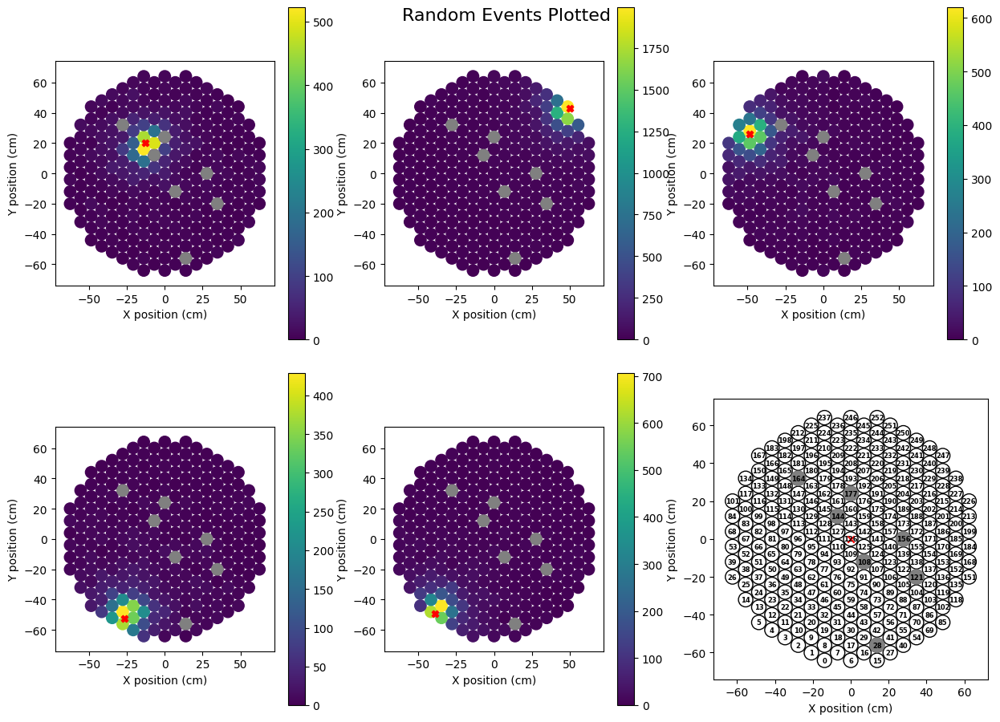

<Figure size 640x480 with 0 Axes>

In [75]:
# Look at some patterns
fig, ax = plt.subplots(2,3, figsize=(15,10))
fig.suptitle("Random Events Plotted", fontsize=16)
ax = ax.flatten()
vmax = np.max(patterns)
vmin = 1
for i in ax[:-1]:
    idx = random.randint(0, patterns.shape[0])
    plot_pmt_response(pmt_pos_top, response=patterns[idx].numpy(), ax = i, title=None, vmax=None, vmin=None, logscale=False, dead_pmts=dead_pmts)
    i.scatter(ei[idx]['x'], ei[idx]['y'], c = 'r', marker = 'X')
_ax = plot_pmt_indeces(pmt_pos_top,ax=ax[-1],fontsize=6, dead_pmts=dead_pmts) 
_ax.scatter(0,0, c='r',marker='x')
plt.subplots_adjust(top=0.98, hspace=0.1)
plt.show()
plt.tight_layout()

## LCE Coordinates

Make a model that computes a number of different coordinates for future models.

In [81]:
def get_full_LCE_coordinate_model(n_pmts, pmt_positions, n_pmt_pos = 6):
    """
    Generates all coordinates we will require later
    """
    conv_pmt_coords = keras.models.Sequential([
        keras.layers.RepeatVector(n_pmts, input_shape=(2,)),
        GetFullCoordinateSystem((n_pmts, n_pmt_pos), keras.backend.variable(pmt_positions))
        #keras.layers.Lambda(positions_to_norm_coords,
        #    output_shape = (n_pmts, n_pmt_pos),
        #    arguments = dict(pmt_positions=keras.backend.variable(pmt_positions))
        #)
    ], name='xy_to_pmt_coords')
    return conv_pmt_coords
def get_minimal_LCE_coordinate_model(n_pmts, pmt_positions, n_pmt_pos = 1):
    """
    Generate's PMT Position coordinate, the main one used for now
    """
    conv_pmt_coords = keras.models.Sequential([
        keras.layers.RepeatVector(n_pmts, input_shape=(2,)),
        GetRadius((n_pmts, n_pmt_pos), keras.backend.variable(pmt_positions)),
        #keras.layers.Lambda(get_r_event_pmt,
        #    output_shape = (n_pmts, n_pmt_pos),
        #    arguments = dict(pmt_positions=keras.backend.variable(pmt_positions))
        #)
    ], name='xy_to_pmt_coords')
    return conv_pmt_coords


1563/1563 [==============================] - 3s 2ms/step


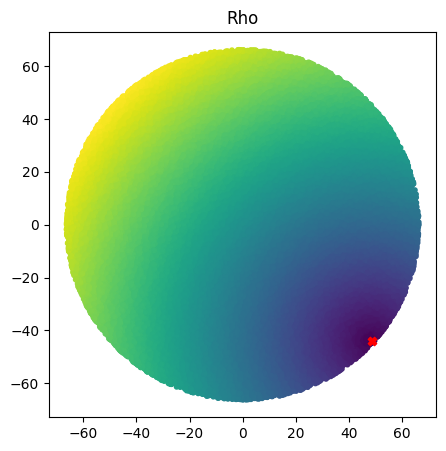

In [58]:
# Quick Check
conv_pmt_coords =  get_full_LCE_coordinate_model(n_pmts = n_pmts, pmt_positions = pmt_pos_top[:,2:])
clear_output() # Clear the untracked variable warning
# Generate random points in a circle
def generate_circle_points(radius, num_points=100):
    points = np.zeros((num_points, 2))
    for i in range(num_points):
        r = radius * np.sqrt(np.random.rand())  
        angle = 2 * np.pi * np.random.rand()    
        x = r * np.cos(angle)
        y = r * np.sin(angle)
        points[i] = [x, y]
    return points
fig, ax = plt.subplots(1,1, figsize=(5,5))
_test_pmt = random.randint(0, n_pmts)
xy = generate_circle_points(tpc_radius, num_points=50000)
_pos_data = conv_pmt_coords.predict([xy])
ax.scatter(*(xy.T), c= _pos_data[:,_test_pmt,0],s =10)
ax.set_title('Rho')
ax.scatter(pmt_pos_top[_test_pmt,2], pmt_pos_top[_test_pmt,3], c = 'r', marker = 'X')

1563/1563 [==============================] - 1s 552us/step


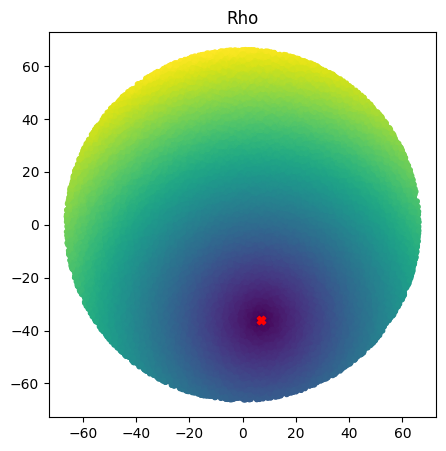

In [10]:
# Quick Check
conv_pmt_coords =  get_minimal_LCE_coordinate_model(n_pmts = n_pmts, pmt_positions = pmt_pos_top[:,2:])
clear_output() # Clear the untracked variable warning
# Generate random points in a circle
def generate_circle_points(radius, num_points=100):
    points = np.zeros((num_points, 2))
    for i in range(num_points):
        r = radius * np.sqrt(np.random.rand())  
        angle = 2 * np.pi * np.random.rand()    
        x = r * np.cos(angle)
        y = r * np.sin(angle)
        points[i] = [x, y]
    return points
fig, ax = plt.subplots(1,1, figsize=(5,5))
_test_pmt = random.randint(0, n_pmts)
xy = generate_circle_points(tpc_radius, num_points=50000)
_pos_data = conv_pmt_coords.predict([xy])
ax.scatter(*(xy.T), c= _pos_data[:,_test_pmt],s =10)
ax.set_title('Rho')
ax.scatter(pmt_pos_top[_test_pmt,2], pmt_pos_top[_test_pmt,3], c = 'r', marker = 'X')

## Uniform LCE

Lets test for the Loss minimal loss using a uniform LCE

Minimal uniform I0 0.014492753623188406, chi^2/ndf : 100.14264678955078


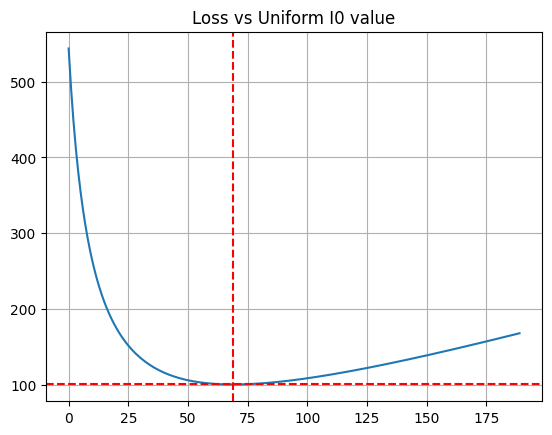

In [11]:
patterns_tmp = tensorflow.gather(patterns, val_slice, axis=0)
tst = [tensorflow.math.reduce_mean(keras_loss(patterns_tmp, tensorflow.ones((len(val_slice), n_pmts), dtype=tensorflow.float32)/i)) for i in range(10,200)]
tst_no_nan = tensorflow.where(tensorflow.math.is_nan(tst), tensorflow.constant(float('inf')), tst)
minidx = tensorflow.argmin(tst_no_nan)
I0_init_from_ULCE = 1/minidx
plt.plot(tst)
plt.axvline(minidx, linestyle = 'dashed',c='r')
plt.axhline(tst[minidx], linestyle = 'dashed',c='r')
plt.grid()
plt.title("Loss vs Uniform I0 value")
print("Minimal uniform I0 {}, chi^2/ndf : {}".format(I0_init_from_ULCE, tst[minidx]))  

## Pointlike PMT's

One coefficient for each PMT using a trivial LCE model

We also solve for d

In [12]:
def get_pointlike_model(pmt_pos_top, d, I0_init,add_noise = False, std = 3): 
    """
    Generate Radial LCE Model for fitting
    """
    n_pmts = len(pmt_pos_top)
    def radial_lce(de, d):
        """
        Radial LCE model with the trivial variables
        Here with all vars plugged in:
        (1-0)/(1 + (de/d)**2)**1 + (0 * de) + 0
        """
        return tensorflow.math.pow(1 + tensorflow.math.square(de/d), -1)
    # Input layer
    input_pos = keras.layers.Input(shape=(2))
    if add_noise:
        m = keras.layers.GaussianNoise(std, seed=None)(input_pos)
    else:
        m = input_pos
    # Get different coordinates
    m = get_minimal_LCE_coordinate_model(n_pmts = n_pmts, pmt_positions = pmt_pos_top, n_pmt_pos = 1)(input_pos)
    # Apply radial lce 
    #m = keras.layers.Lambda(partial(radial_lce, d=d), name='trivial_lce')(m)
    tmp = RadialLCELayer(guess = [0, d, 0, 0], n_groups=1, group_slices=[1], name='trivial_lce_layer')
    tmp.trainable = False
    m = tmp(m)
    # Holds I0 for each PMT
    m = I0Layer(n_pmts, init_val= tensorflow.cast(I0_init, tensorflow.float32), name='I0Layer')(m)
    # Normalization Layer 
    #m = keras.layers.Lambda(normalize)(m)
    m = NormalizationLayer(name='Normalization')(m)
    return keras.models.Model(inputs=input_pos, outputs=m, name="Trivial_LCE")

Minimum loss for d = 5.4


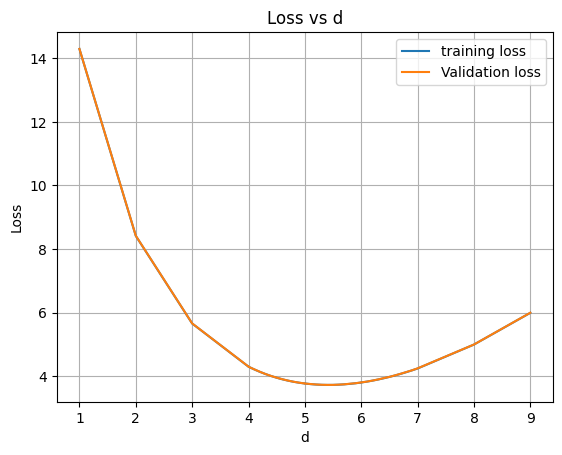

In [23]:
# Solve for d
# Lets see what d best fits the function
# Many trials to make the plot nice
you_are_sure = False # THis cell takes really long
if you_are_sure:
    trials = [i for i in range(1, 10)]
    trials += [4+i/10 for i in range(0,30)]
    trials = np.array(trials)
    trials.sort()

    x_train = tensorflow.gather(positions, train_slice, axis=0)
    y_train = tensorflow.gather(patterns, train_slice, axis=0)
    val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
    histories = []
    for i in trials:
        trivial_lce = get_pointlike_model(pmt_pos_top[:,2:], d = i, I0_init=I0_init_from_ULCE)
        trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-4))
        hist = trivial_lce.fit(x = x_train, y = y_train, 
                        validation_data=val,
                        epochs = 3, batch_size = 2**8, verbose = 0)
        histories.append(hist)
    clear_output()
    # Generate default for else
    for i in range(len(histories)):
        print((histories[i].history['loss'][-1], histories[i].history['val_loss'][-1]))

    print('['+','.join([str(i) for i in trials])+']')
else:
    class Dummy:
        def __init__(self, hist):
            self.history = {}
            self.history['loss'] = [hist[0]]
            self.history['val_loss'] = [hist[1]]
            return
    # The below are printed and copied to make sure we dont need to compute everything again
    trials = [1.0,2.0,3.0,4.0,4.0,4.1,4.2,4.3,4.4,4.5,4.6,4.7,4.8,4.9,5.0,5.0,5.1,5.2,5.3,5.4,5.5,5.6,5.7,5.8,5.9,6.0,6.0,6.1,6.2,6.3,6.4,6.5,6.6,6.7,6.8,6.9,7.0,8.0,9.0]
    hists = [(14.293724060058594, 14.295296669006348),(8.413986206054688, 8.41763973236084),(5.65730094909668, 5.659842491149902),(4.298768997192383, 4.302179336547852),(4.299088001251221, 4.2976861000061035),(4.214634418487549, 4.21756649017334),(4.138015270233154, 4.139974117279053),(4.069019794464111, 4.069100856781006),(4.006522178649902, 4.007017135620117),(3.9514694213867188, 3.953563928604126),(3.902874708175659, 3.9048051834106445),(3.8608174324035645, 3.86203932762146),(3.824577569961548, 3.8251993656158447),(3.7944228649139404, 3.795854091644287),(3.770202398300171, 3.7703123092651367),(3.769932270050049, 3.7705111503601074),(3.7513105869293213, 3.7541849613189697),(3.737877130508423, 3.7391393184661865),(3.7292230129241943, 3.730034589767456),(3.7259552478790283, 3.726754665374756),(3.727418899536133, 3.7268242835998535),(3.733508825302124, 3.7351906299591064),(3.744170904159546, 3.745274543762207),(3.7592661380767822, 3.764279842376709),(3.778557300567627, 3.7794137001037598),(3.8019793033599854, 3.8045237064361572),(3.801914691925049, 3.80505633354187),(3.830199956893921, 3.8298823833465576),(3.861445188522339, 3.862661361694336),(3.8964591026306152, 3.8986873626708984),(3.9358952045440674, 3.9403316974639893),(3.978628396987915, 3.978785991668701),(4.024923324584961, 4.026587009429932),(4.074497699737549, 4.077404022216797),(4.1276326179504395, 4.131603240966797),(4.184156894683838, 4.18497896194458),(4.243241310119629, 4.2474236488342285),(4.995960712432861, 4.997480392456055),(5.994515895843506, 5.997439384460449)]
    histories = []
    for i in hists:
        histories.append(Dummy(i))

# POlot and get d
loss = []
val_loss = []
for i in range(len(histories)):
    loss.append(histories[i].history['loss'][-1])
    val_loss.append(histories[i].history['val_loss'][-1])
#sorted_pairs = sorted(zip(trials, loss, val_loss))  # Sort by the first element in each pair (x values)
#trials, loss, val_loss = zip(*sorted_pairs)
plt.plot(trials,loss, label = 'training loss')
plt.plot(trials,val_loss, label = 'Validation loss')
plt.legend()
plt.title("Loss vs d")
plt.xlabel("d")
plt.ylabel('Loss')
trivial_d = (trials[np.argmin(loss)] + trials[np.argmin(val_loss)])/2
print("Minimum loss for d = {}".format(trivial_d)) # 4.85
plt.grid()
plt.show()

Epoch 1/100
5887/5887 [==============================] - 10s 2ms/step - loss: 205.9261 - val_loss: 203.7690
Epoch 2/100
5887/5887 [==============================] - 10s 2ms/step - loss: 203.9314 - val_loss: 203.7613
Epoch 2: early stopping


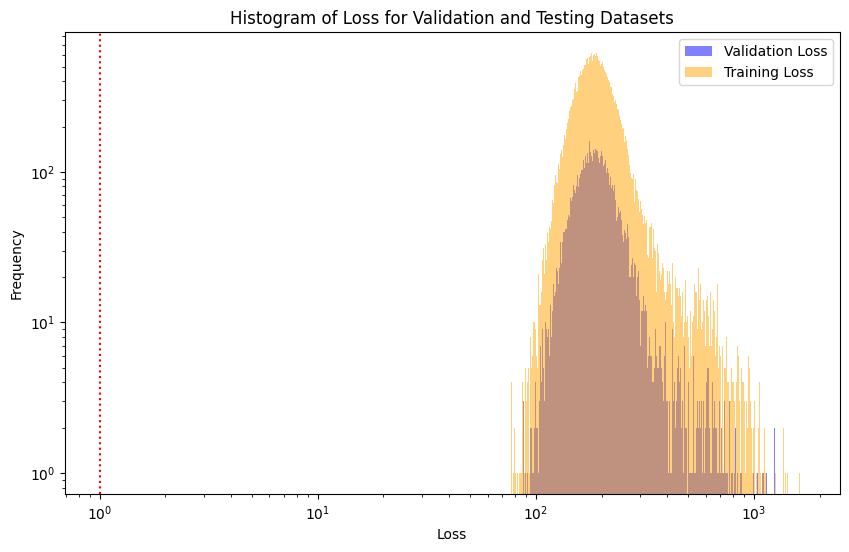

In [81]:
# Train trivial with d_trivial -> I0's & plot < - Note this is overkill
trivial_lce = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE,add_noise = False, std = 0.1)
clear_output() # Clear the untracked variable + lambda warning
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=1,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.05,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
trivial_lce.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 100, batch_size = 2**4, 
                callbacks=[early_stopping])

# Medians  (always reverts back to weights from first epoch -> High bs)
#-------------------------------------------
# Unmodified Data  No Noise : 3.347
# Unmodified Data  Noise    : 3.347 @ std 0.1
# Unmodified Data  Noise    : 3.448 @ std 1
# Unmodified Data  Noise    : 3.348 @ std 2
# Unmodified Data  Noise    : 3.348 @ std 3
# Unmodified Data  Noise    : 3.347 @ std 4
#------------------------------------------
# No point in adding noise (note that i didnt actually modify val data only train)
# I jsut noticed we dont actually care about the median in this comparison
# TODO Mean or smthing

val_loss, train_loss = plot_loss_histogram(trivial_lce, (x_train, y_train), val, loss_func=keras_loss, bins=1000)

Overall Median Value: 187.84036254882812


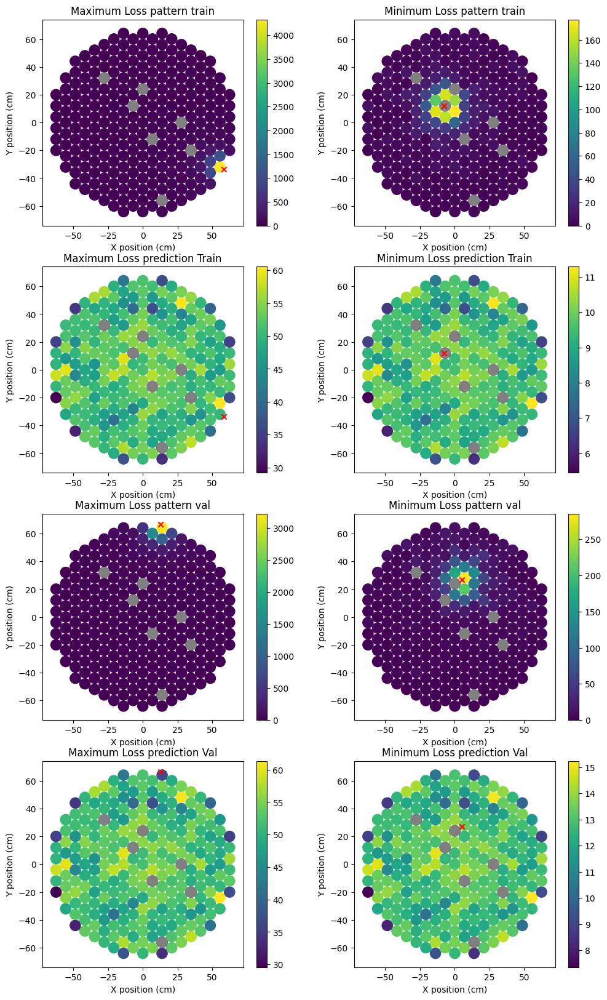

In [82]:
_ = plot_max_min_loss(trivial_lce, train_loss, val_loss, x_train, y_train, val,dead_pmts, pmt_pos_top)

# Jelle Help Required

Interpreting Data below

Correlation between mean of patterns per PMT and acceptance is expected? - > Since this is what I0 is supposed to fit

See last plot of binning -> Random enough -> So no problem

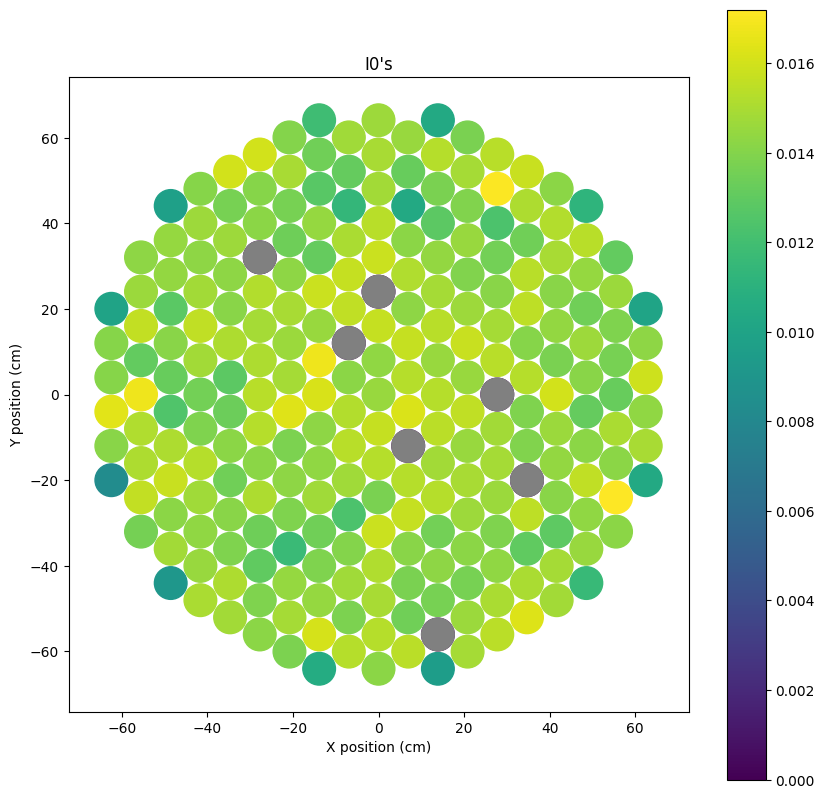

In [83]:
_ = plot_pmt_response(pmt_pos_top, response=trivial_lce.layers[-2].weights[0].numpy(), ax = None, title="I0's", vmax=None, vmin=None, logscale=False, dead_pmts=dead_pmts)

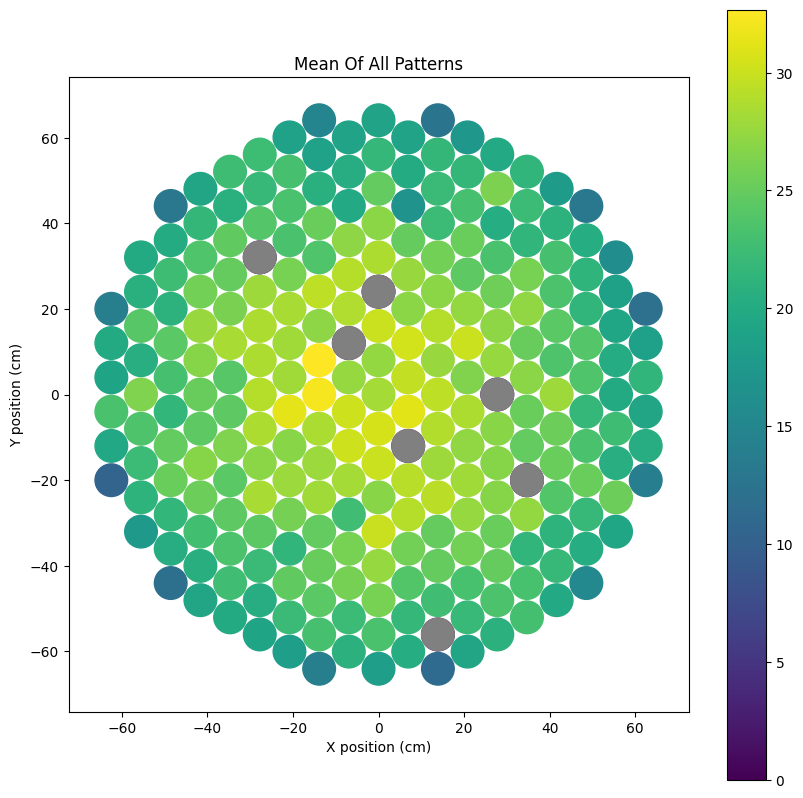

In [84]:
_ = plot_pmt_response(pmt_pos_top, response=patterns.numpy().mean(axis=0), ax = None, title="Mean Of All Patterns", vmax=None, vmin=None, logscale=False, dead_pmts=dead_pmts)

Correlation between predicted I0's and mean pattern value  0.6865807667633961


/tmp/ipykernel_81/54100979.py:3: RuntimeWarning: invalid value encountered in divide
  tmp = trivial_lce.layers[-2].weights[0].numpy()/patterns.numpy().mean(axis=0)


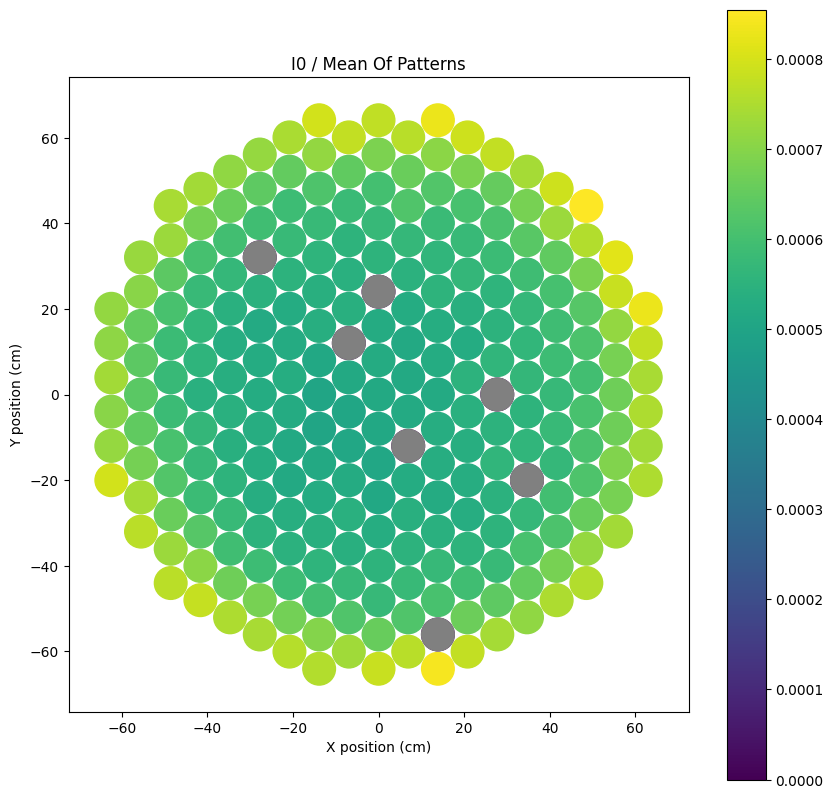

In [85]:
corr = np.corrcoef(patterns.numpy().mean(axis=0)[not_dead_pmts], trivial_lce.layers[-2].weights[0].numpy()[not_dead_pmts])
print("Correlation between predicted I0's and mean pattern value ", corr[0,1])
tmp = trivial_lce.layers[-2].weights[0].numpy()/patterns.numpy().mean(axis=0)
tmp[np.isnan(tmp)] = 0
_ = plot_pmt_response(pmt_pos_top, response=tmp, ax = None, title="I0 / Mean Of Patterns", vmax=None, vmin=None, logscale=False, dead_pmts=dead_pmts)

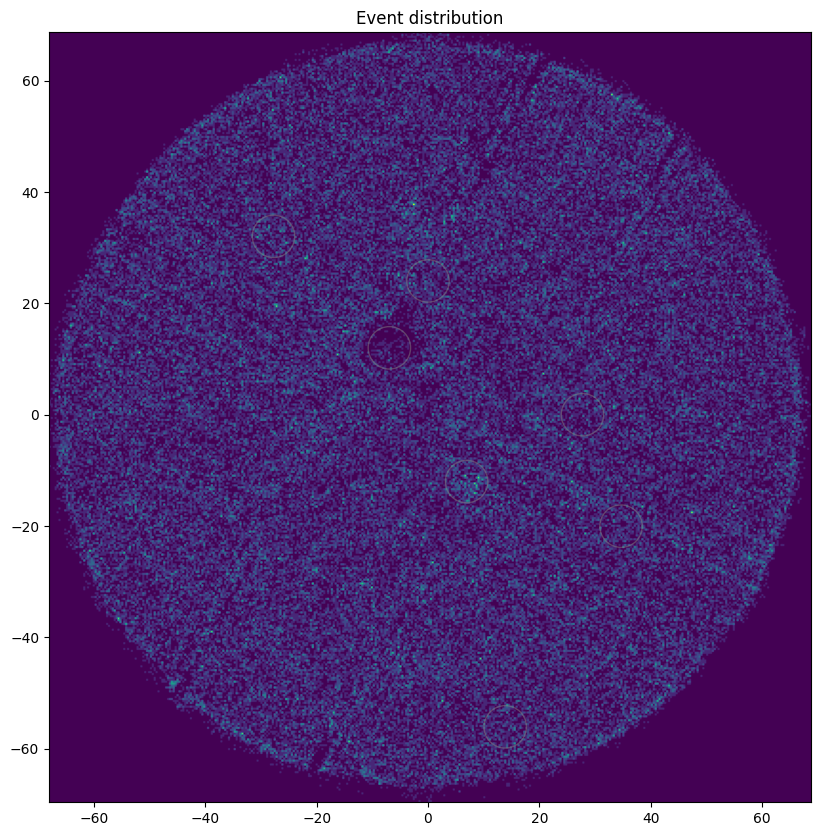

In [86]:
fig, ax = plt.subplots(1,1,figsize=(10,10))
ax = [ax]
ax[0].set_title('Event distribution')
_x, _y  = positions[:,0], positions[:,1]
_bool_map = ~(np.isnan(_x) | np.isnan(_y))
heatmap_data, x_edges, y_edges = np.histogram2d(_x[_bool_map],_y[_bool_map], bins=400)
# Plot the heatmap using imshow
img = ax[0].imshow(heatmap_data.T, extent=[x_edges[0], x_edges[-1], y_edges[0], y_edges[-1]], origin='lower', cmap='viridis')
for i in dead_pmts:
        circle = plt.Circle((pmt_pos_top[i,-2], pmt_pos_top[i,-1]),  3  * 2.54 / 2, color='grey', alpha = 0.5, fill=False)
        ax[0].add_artist(circle)

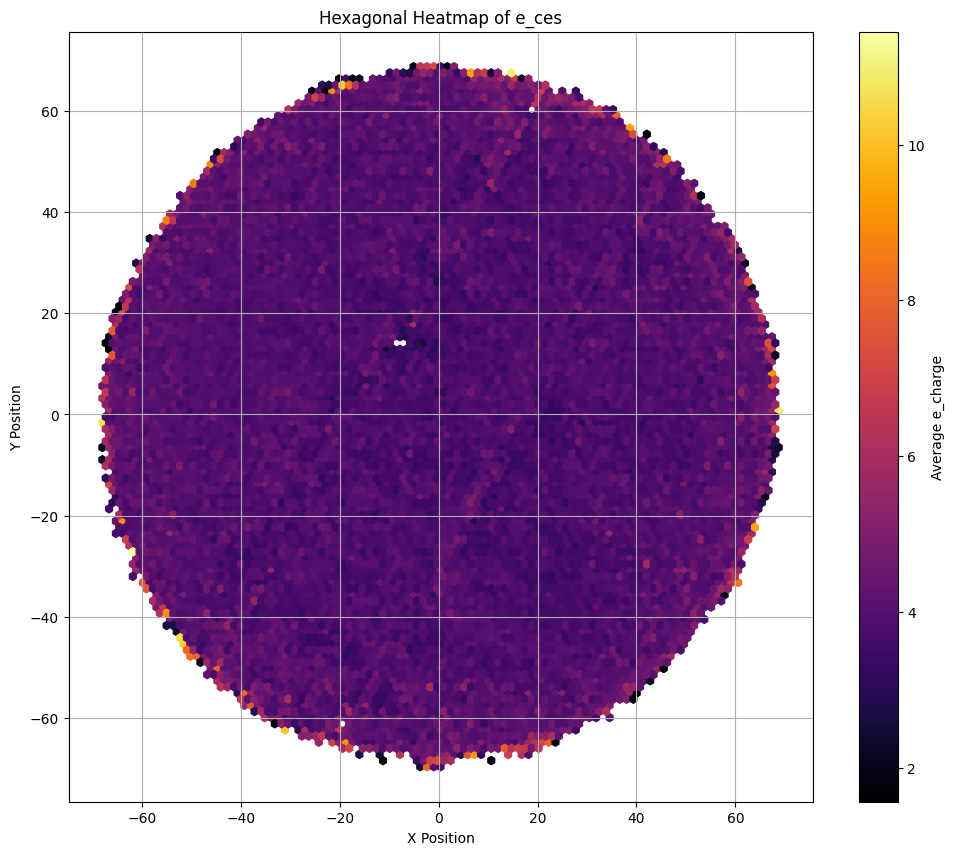

In [87]:
plt.figure(figsize=(12, 10))
hb = plt.hexbin(ei['x'], ei['y'], C=ei['e_charge'], gridsize=100, cmap='inferno', mincnt=1)

# Add a color bar to indicate values
cb = plt.colorbar(hb)
cb.set_label('Average e_charge')

plt.title('Hexagonal Heatmap of e_ces')
plt.xlabel('X Position')
plt.ylabel('Y Position')
plt.grid()
plt.show()

Correlation between predicted I0's and binned data  0.556636983793115


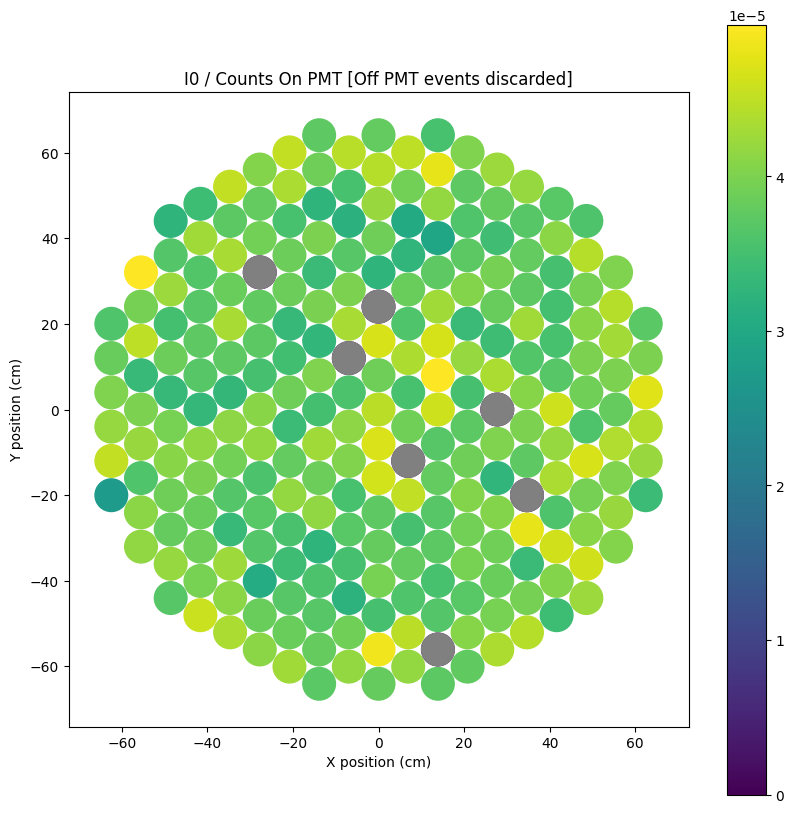

In [88]:
bin_mask, bin_counts = bin_events_to_pmt(positions, pmt_pos_top[:,2:], do_not_discard=False)
corr = np.corrcoef(patterns.numpy().mean(axis=0)[not_dead_pmts], bin_counts[not_dead_pmts])
print("Correlation between predicted I0's and binned data ", corr[0,1])
tmp = trivial_lce.layers[-2].weights[0].numpy()/bin_counts
tmp[np.isnan(tmp)] = 0
_ = plot_pmt_response(pmt_pos_top, response=tmp, ax = None, title="I0 / Counts On PMT [Off PMT events discarded]", vmax=None, vmin=None, logscale=False, dead_pmts=dead_pmts)

## Radial LCE

The above appears to reach close to the limit of what we can expect from the current data, using radial LCE with n_pmts individual groups reached a slightly better fit value but not significantly


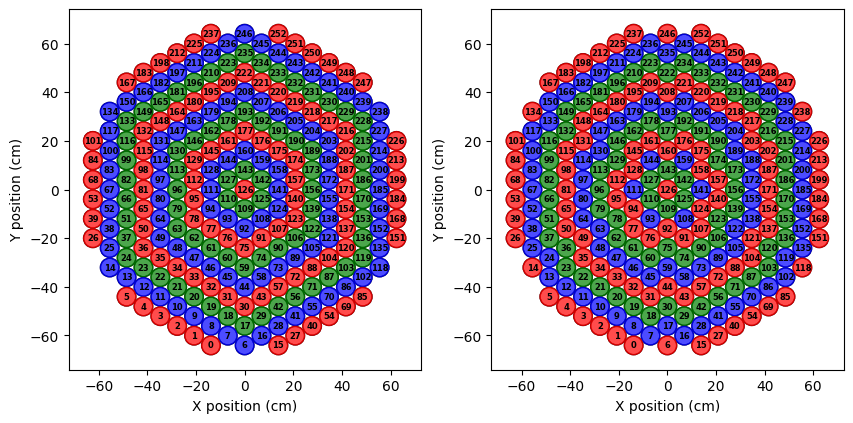

In [89]:
# Groups

fig, ax = plt.subplots(1,2,figsize=(10,5))

pmt_groups = get_ring_group_with_edge()
_ = plot_ring_group(pmt_groups,pmt_pos_top, ax[0])

pmt_groups = get_ring_group_without_edge()
_ = plot_ring_group(pmt_groups,pmt_pos_top, ax[1])
    

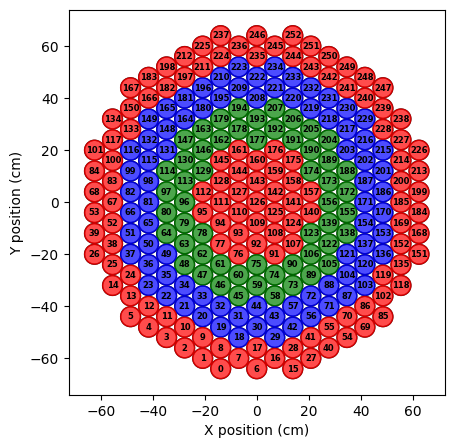

In [90]:
# Manual 
pmt_groups = man_group_4_ring()
fig, ax = plt.subplots(1,1,figsize=(5,5))
_ = plot_ring_group(pmt_groups,pmt_pos_top, ax)

In [13]:
def get_RLCEModel(pmt_pos_top,n_pmts, n_groups, group_slices, I0_init, guess, add_noise = False, std = 3):
    """
    Generate Radial LCE Model for fitting
    """
    def normalize(X):
        """
        Converts LCE to the fraction of light seen per PMT
        """
        X /= keras.backend.reshape(keras.backend.sum(X, axis=1), (-1, 1))
        return X
    # Input layer
    input_pos = keras.layers.Input(shape=(2))
    if add_noise:
        m = keras.layers.GaussianNoise(std, seed=None)(input_pos)
    else:
        m = input_pos
    # Get different coordinates
    m = get_minimal_LCE_coordinate_model(n_pmts = n_pmts, pmt_positions = pmt_pos_top, n_pmt_pos = 1)(m)
    # Apply radial lce 
    m = RadialLCELayer(name='radial_lce',guess= guess, n_groups=n_groups, group_slices=group_slices)(m)
    # Holds I0 for each PMT
    m = I0Layer(n_pmts, init_val= tensorflow.cast(I0_init, tensorflow.float32), name='QE_Layer')(m)
    #m = I0Layer(n_pmts, init_val= I0_init, name='QE_Scaler')(m)
    # Normalization Layer 
    m = keras.layers.Lambda(normalize)(m)
    return keras.models.Model(inputs=input_pos, outputs=m, name="Radial_LCE")

## Update Pos Model

We want to update the positions to improve the goodness of fit of our model


In [14]:
def get_position_updater(positions, n_to_update, model,input_len = 1):
    """
    Returns encoder model to get patterns from positions
    """
    input = keras.layers.Input(shape=(input_len,))
    m = keras.layers.Embedding(n_to_update, 2, input_length = input_len, name='embed_pos')(input)
    m = keras.layers.Flatten()(m)
    m = model(m)
    pos_updater = keras.models.Model(inputs= input, outputs=m, name="Position_Updater")
    pos_updater.layers[-1].trainable = False
    pos_updater.get_layer('embed_pos').set_weights([positions[:n_to_update]])

    return pos_updater


#------------------------ Some utility functions -------------------------------
def split_data(positions, patterns):
    x_train = tensorflow.gather(positions, train_slice, axis=0)
    y_train = tensorflow.gather(patterns, train_slice, axis=0)
    val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
    return x_train, y_train, val


## Testing Different Groups with Position jittering

One single position refit and retraining rLCE and I0s gets pretty close to the limit of this method, improvements do still happen but they are too insignificant for the amount of time required



Each gets its own subheading we have:
- 1 group
- n_pmt groups
- manual group from 2 cells up

Note all of these cells take really long to run due to 6 fitting cycles, low
batch sizes and dynamic learning rate adjustment 5min per cell on my device

A note on resuls notation
- rLCE train + refit pos
    - We train rLCE on positions, refit the positions, last median is rLCE trained on positions and used on refit pos
- rLCE train2
    - rLCE trained on refit pos and evaluated on refit pos
- refit pos2 
    - refit pos using rLCE train2 and eval on refit pos2
- rLCE train3 
    - rLCE trained on refit pos2 and evaluated on refit pos2

Note that a lot of extra time is included in the cell times due to plotting etc

In [30]:
#-------------------------------- Helper funcs ---------------------------------
def train_and_update_pos(positions, patterns, model, n_iter = 5, verbose=0, hist_pos=False):
    early_stopping = tensorflow.keras.callbacks.EarlyStopping(
        monitor='loss',
        restore_best_weights=True,
        patience=4,    
        min_delta=0.05,
        mode='min',    
        verbose=1      
    )
    reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
        monitor='loss', 
        mode = 'min',
        factor=0.5,     
        patience=2,     
        min_delta=0.05, 
        min_lr=1e-3,    
        verbose=1       
    )
    n_tot = len(positions)
    pos_updater = get_position_updater(positions, n_tot, model ,input_len = 1)
    # Inspecting the degree of change
    if hist_pos:
        trained_pos = []

    new_pos = tensorflow.identity(positions)
    loss    = keras_loss(patterns, model.predict(positions))
    improved= np.zeros(positions.shape[0])
    improved[:] = -1
    for i in range(n_iter):
        print("Jagged iter {}".format(i))
        # tensorflow_probability requires tf >= 2.16 we have == 2.15
        # Random dist gives max deviation root{2}*pmt_radius (~70% of diameter)
        noise_pos = tensorflow.identity(positions) + np.random.rand(*new_pos.numpy().shape) * pmt_radius
        # Update and fit encoder model positions
        pos_updater.get_layer('embed_pos').set_weights([noise_pos])
        # Compile and fit
        pos_updater.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-1))
        pos_updater.fit(x = np.arange(n_tot), y = patterns, 
                        epochs = 20, batch_size = 2**12,
                        callbacks=[early_stopping,reduce_lr], verbose = verbose) 
        noise_pos = pos_updater.get_layer('embed_pos').get_weights()[0]
        # Check result of new pos
        jittered_loss = keras_loss(patterns, model.predict(noise_pos, verbose=verbose))

        better = jittered_loss < loss
        loss =    tensorflow.where(better, jittered_loss, loss) 
        new_pos = tensorflow.where(tensorflow.expand_dims(better, axis=-1), noise_pos, new_pos) 
        improved[better.numpy()] = i
        if hist_pos:
            trained_pos.append(noise_pos)

    print("Jittering Results")
    print("Didnt improve : {}%".format((improved == -1).mean()*100))
    for i in range(n_iter):
        print("Iteration {} : {}%".format(i, (improved == i).mean()*100))
    if not hist_pos:
        return new_pos
    else:
        return new_pos, trained_pos

def get_I0s(positions, patterns, val_slice, train_slice):
    """Recompute I0's based on updated positions"""
    x_train = tensorflow.gather(positions, train_slice, axis=0)
    y_train = tensorflow.gather(patterns, train_slice, axis=0)
    val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

    trivial_lce_refit = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE,add_noise = False, std = 0.1)
    early_stopping = tensorflow.keras.callbacks.EarlyStopping(
        monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
        patience=1,            # Wait for 2 epochs with no improvement
        restore_best_weights=True,
        min_delta=0.05,        # Minimum change of abs value (4 loss is a common starting point)
        mode='min',            # 'min' because we want to minimize the loss
        verbose=1              # Print messages when stopping
    )
    trivial_lce_refit.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
    trivial_lce_refit.fit(x = x_train, y = y_train, 
                    validation_data=val,
                    epochs = 100, batch_size = 2**4, 
                    callbacks=[early_stopping])
    return trivial_lce_refit

### 1 group - limit reached with 1 refit and retrain

Results:
rLCE train + refit pos
- Didnt improve : 0.0050960607450440815%
- Iteration 0 : 21.64976473186227%
- Iteration 1 : 20.64499142163108%
- Iteration 2 : 20.102260952283885%
- Iteration 3 : 19.06266456029489%
- Iteration 4 : 18.535222273182832%
- Overall Median Value: 2.425262212753296

rLCE train2 (using refit pos)
- Overall Median Value: 2.3778767585754395

refit pos2 
- Didnt improve : 4.077697939492772%
- Iteration 0 : 20.078479335473677%
- Iteration 1 : 19.35144133584739%
- Iteration 2 : 19.237629312541404%
- Iteration 3 : 18.74925682447468%
- Iteration 4 : 18.505495252170075%
- Overall Median Value: 2.377110004425049

rLCE train3 (using refit pos2)
- Overall Median Value: 2.3941667079925537

Running time per cell:
- 4m14.1s
- 1m46.9s
- 3m41.2s
- 1m11.6s

Total
- 10m53.8s

The following Variables were used a Lambda layer's call (lambda_15), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
{'name': 'radial_lce'}
Epoch 1/20
1472/1472 [==============================] - 6s 4ms/step - loss: 3.5241 - val_loss: 3.4461 - lr: 1.0000e-05
Epoch 2/20
1472/1472 [==============================] - 5s 4ms/step - loss: 3.4610 - val_loss: 3.4528 - lr: 1.0000e-05
Epoch 3/20
1465/1472 [============================>.] - ETA: 0s - loss: 3.4561
Epoch 3: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-06.
1472/1472 [==============================] - 5s 4ms/step - loss: 3.4562 - val_loss: 3.4393 - lr: 1.0000e-05
Epoch 4/20
1472/1472 [==============================] - 6s 4ms/step - loss: 3.4513 - val_loss: 3.4348 - lr: 

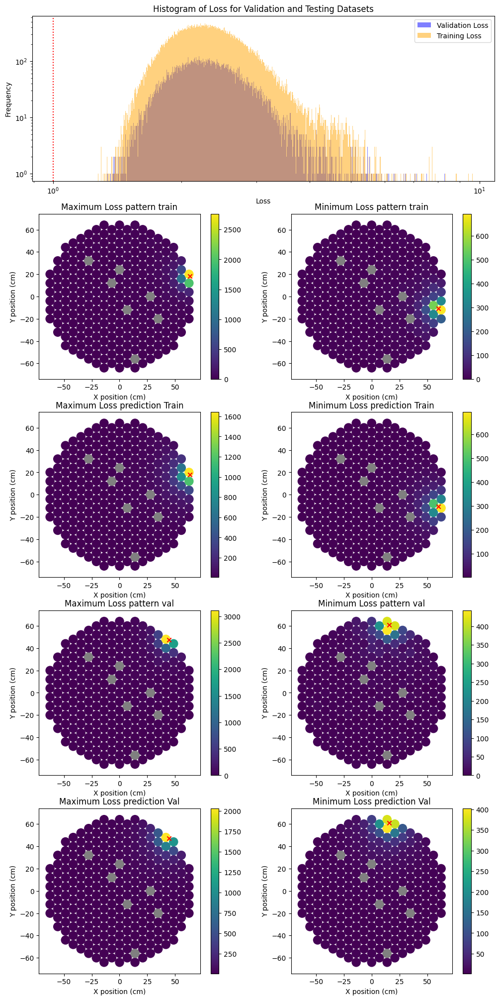

In [93]:
# ---- Apply radial LCE with n_groups=1 and jittering of pos using encoder -----
# ----------------------------------- rLCE -------------------------------------

n_groups = 1 # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=np.arange(n_pmts),
                    I0_init=trivial_lce.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))

x_train, y_train, val = split_data(positions, patterns)
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**6,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

# -------------------------------- pos_updater ---------------------------------
new_pos = train_and_update_pos(positions, patterns, rLCE, n_iter = 5, verbose=0)

x_train = tensorflow.gather(new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


Epoch 1/100
5887/5887 [==============================] - 10s 2ms/step - loss: 205.9280 - val_loss: 203.7768
Epoch 2/100
5887/5887 [==============================] - 9s 2ms/step - loss: 203.9321 - val_loss: 203.7611
Epoch 2: early stopping
The following Variables were used a Lambda layer's call (lambda_18), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
{'name': 'radial_lce'}
Epoch 1/20
1472/1472 [==============================] - 5s 4ms/step - loss: 2.4148 - val_loss: 2.3521 - lr: 1.0000e-05
Epoch 2/20
1472/1472 [==============================] - 5s 3ms/step - loss: 2.3418 - val_loss: 2.3354 - lr: 1.0000e-05
Epoch 3/20
1451/1472 [============================>.] - ETA: 0s - loss: 2.3316
Epoch 3: ReduceLROnPlateau reducing learning rate to 

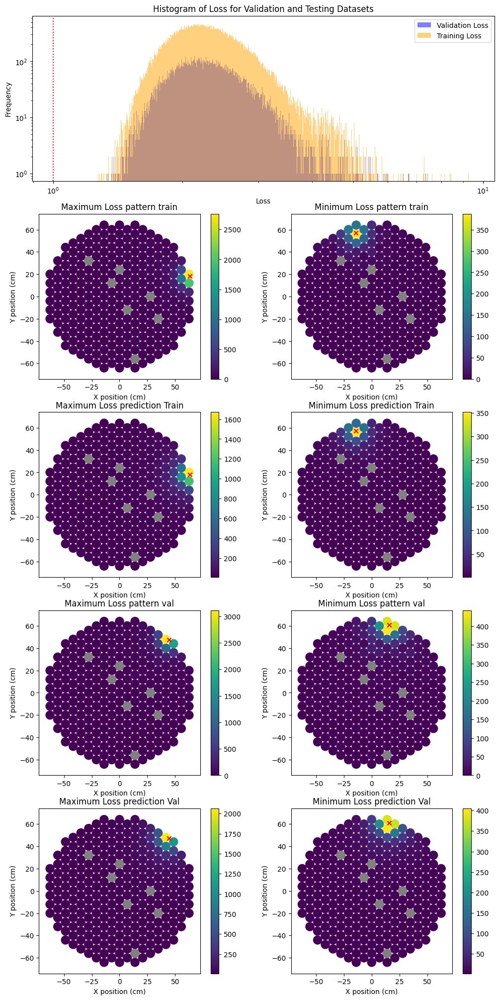

In [94]:
# -------------------------- Refitting pmt response ----------------------------
x_train = tensorflow.gather(new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

trivial_lce_refit = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE,add_noise = False, std = 0.1)
clear_output() # Clear the untracked variable + lambda warning
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=1,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.05,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
trivial_lce_refit.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce_refit.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 100, batch_size = 2**4, 
                callbacks=[early_stopping])

# ------------------------------- Refitting rLCE -------------------------------
n_groups = 1 
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=np.arange(n_pmts),
                    I0_init=trivial_lce_refit.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))


early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**6,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


3680/3680 [==============================] - 2s 512us/step
Jagged iter 0
Epoch 1/20
460/460 [==============================] - 4s 8ms/step - loss: 4.3516 - lr: 0.1000
Epoch 2/20
460/460 [==============================] - 3s 7ms/step - loss: 3.0143 - lr: 0.1000
Epoch 3/20
460/460 [==============================] - 4s 9ms/step - loss: 2.5030 - lr: 0.1000
Epoch 4/20
460/460 [==============================] - 3s 7ms/step - loss: 2.4726 - lr: 0.1000
Epoch 5/20
456/460 [============================>.] - ETA: 0s - loss: 2.5318
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
460/460 [==============================] - 4s 9ms/step - loss: 2.5317 - lr: 0.1000
Epoch 6/20
460/460 [==============================] - 3s 7ms/step - loss: 2.5998 - lr: 0.0500
Epoch 7/20
460/460 [==============================] - 4s 8ms/step - loss: 2.3341 - lr: 0.0500
Epoch 8/20
460/460 [==============================] - 4s 9ms/step - loss: 2.3276 - lr: 0.0500
Epoch 9/20
458/460 [===============

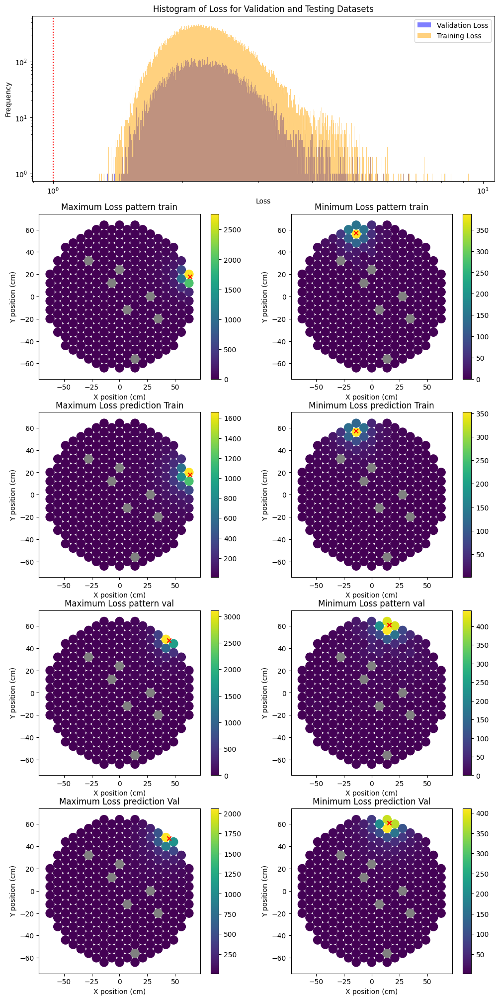

In [95]:
#-------------------------------- new new pos ----------------------------------
new_new_pos = train_and_update_pos(new_pos, patterns, rLCE, n_iter = 5, verbose=0)

x_train = tensorflow.gather(new_new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


The following Variables were used a Lambda layer's call (lambda_20), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
{'name': 'radial_lce'}
Epoch 1/20
1472/1472 [==============================] - 5s 3ms/step - loss: 2.4135 - val_loss: 2.3479 - lr: 1.0000e-05
Epoch 2/20
1472/1472 [==============================] - 5s 3ms/step - loss: 2.3413 - val_loss: 2.3581 - lr: 1.0000e-05
Epoch 3/20
1463/1472 [============================>.] - ETA: 0s - loss: 2.3313
Epoch 3: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-06.
1472/1472 [==============================] - 4s 3ms/step - loss: 2.3312 - val_loss: 2.3247 - lr: 1.0000e-05
Epoch 4/20
1472/1472 [==============================] - 5s 4ms/step - loss: 2.3221 - val_loss: 2.3212 - lr: 

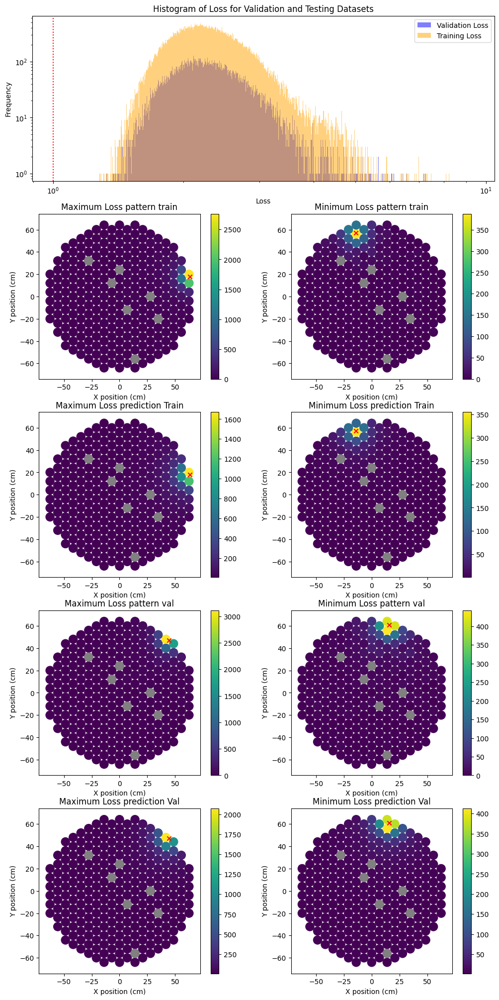

In [96]:
# --------------------------- Last rLCE refit ----------------------------------
_groups = 1 # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=np.arange(n_pmts),
                    I0_init=trivial_lce.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))

x_train = tensorflow.gather(new_new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val    = (tensorflow.gather(new_new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**6,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)

### manual group - limit reached within

Results:
rLCE train + refit pos
- Didnt improve : 0.008493434575073467%
- Iteration 0 : 21.54784351696139%
- Iteration 1 : 20.65773157349369%
- Iteration 2 : 20.059793779408515%
- Iteration 3 : 19.0983369855102%
- Iteration 4 : 18.627800710051133%
- Overall Median Value: 2.4328479766845703

rLCE train2 (using refit pos)
- Overall Median Value: 2.355560064315796

refit pos2 
- Didnt improve : 0.10361990181589631%
- Iteration 0 : 20.612716370245803%
- Iteration 1 : 20.383393636718814%
- Iteration 2 : 20.059793779408515%
- Iteration 3 : 19.73279654826819%
- Iteration 4 : 19.10767976354278%
- Overall Median Value: 2.33956170082092

rLCE train3 (using refit pos2)
- Overall Median Value: 2.338009834289551

Running time per cell:
- 6m09.2s
- 1m46.9s
- 5m37.3s
- 1m57.7s


Total
- 14m39.1s

The following Variables were used a Lambda layer's call (lambda_22), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
{'name': 'radial_lce'}
Epoch 1/20
1472/1472 [==============================] - 5s 3ms/step - loss: 3.5082 - val_loss: 3.4127 - lr: 1.0000e-05
Epoch 2/20
1472/1472 [==============================] - 5s 4ms/step - loss: 3.4117 - val_loss: 3.3872 - lr: 1.0000e-05
Epoch 3/20
1472/1472 [==============================] - 6s 4ms/step - loss: 3.3855 - val_loss: 3.3621 - lr: 1.0000e-05
Epoch 4/20
1472/1472 [==============================] - 6s 4ms/step - loss: 3.3673 - val_loss: 3.3442 - lr: 1.0000e-05
Epoch 5/20
1457/1472 [============================>.] - ETA: 0s - loss: 3.3542
Epoch 5: ReduceLROnPlateau reducing learning rate to 4

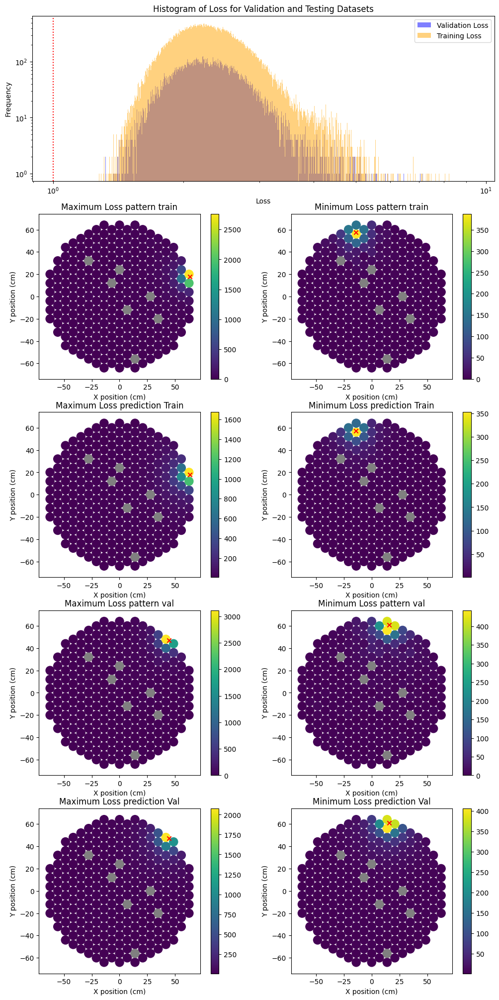

In [97]:
# --- Apply radial LCE with manual groups and jittering of pos using encoder ---
# ----------------------------------- rLCE -------------------------------------

n_groups = 4 # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=man_group_4_ring(),
                    I0_init=trivial_lce.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**6,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

# -------------------------------- pos_updater ---------------------------------
new_pos = train_and_update_pos(positions, patterns, rLCE, n_iter = 5, verbose=0)


x_train = tensorflow.gather(new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


Epoch 1/100
5887/5887 [==============================] - 9s 1ms/step - loss: 205.9338 - val_loss: 203.7781
Epoch 2/100
5887/5887 [==============================] - 11s 2ms/step - loss: 203.9348 - val_loss: 203.7544
Epoch 2: early stopping
The following Variables were used a Lambda layer's call (lambda_25), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
{'name': 'radial_lce'}
Epoch 1/20
1472/1472 [==============================] - 6s 4ms/step - loss: 2.3845 - val_loss: 2.2877 - lr: 1.0000e-05
Epoch 2/20
1472/1472 [==============================] - 6s 4ms/step - loss: 2.2788 - val_loss: 2.2723 - lr: 1.0000e-05
Epoch 3/20
1467/1472 [============================>.] - ETA: 0s - loss: 2.2700
Epoch 3: ReduceLROnPlateau reducing learning rate to 

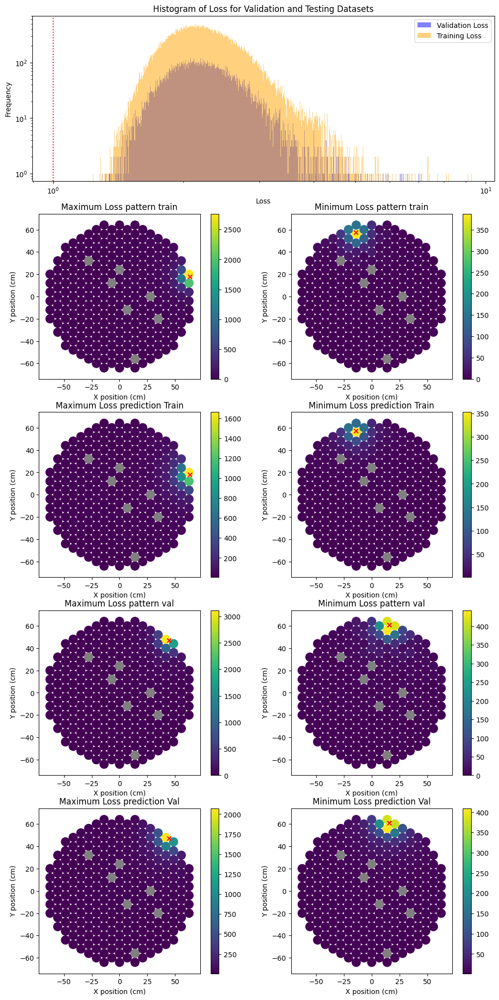

In [98]:
# -------------------------- Refitting pmt response ----------------------------
trivial_lce = get_I0s(positions, patterns, val_slice, train_slice)
# ------------------------------- Refitting rLCE -------------------------------
n_groups = 4 # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=man_group_4_ring(),
                    I0_init=trivial_lce.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False
rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))


early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**6,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


3680/3680 [==============================] - 4s 975us/step
Jagged iter 0
Epoch 1/20
460/460 [==============================] - 4s 7ms/step - loss: 4.2930 - lr: 0.1000
Epoch 2/20
460/460 [==============================] - 3s 6ms/step - loss: 2.9458 - lr: 0.1000
Epoch 3/20
460/460 [==============================] - 3s 7ms/step - loss: 2.4309 - lr: 0.1000
Epoch 4/20
460/460 [==============================] - 4s 8ms/step - loss: 2.3987 - lr: 0.1000
Epoch 5/20
456/460 [============================>.] - ETA: 0s - loss: 2.4575
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
460/460 [==============================] - 3s 7ms/step - loss: 2.4573 - lr: 0.1000
Epoch 6/20
460/460 [==============================] - 4s 8ms/step - loss: 2.5270 - lr: 0.0500
Epoch 7/20
460/460 [==============================] - 4s 9ms/step - loss: 2.2608 - lr: 0.0500
Epoch 8/20
460/460 [==============================] - 2s 5ms/step - loss: 2.2543 - lr: 0.0500
Epoch 9/20
458/460 [===============

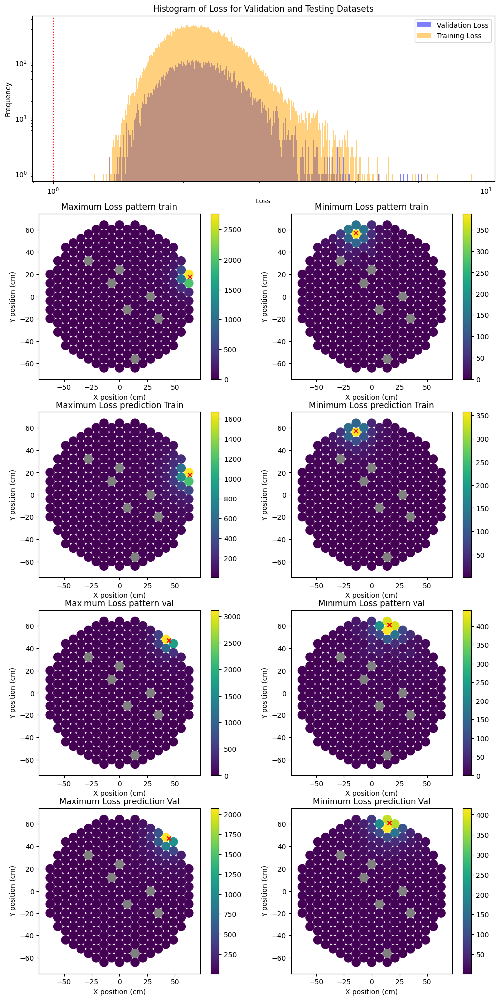

In [99]:
#-------------------------------- new new pos ----------------------------------
new_new_pos = train_and_update_pos(new_pos, patterns, rLCE, n_iter = 5, verbose=0)

x_train = tensorflow.gather(new_new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


The following Variables were used a Lambda layer's call (lambda_27), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
{'name': 'radial_lce'}
Epoch 1/20
1472/1472 [==============================] - 5s 3ms/step - loss: 2.3772 - val_loss: 2.2804 - lr: 1.0000e-05
Epoch 2/20
1472/1472 [==============================] - 5s 3ms/step - loss: 2.2641 - val_loss: 2.2586 - lr: 1.0000e-05
Epoch 3/20
1467/1472 [============================>.] - ETA: 0s - loss: 2.2564
Epoch 3: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-06.
1472/1472 [==============================] - 5s 4ms/step - loss: 2.2563 - val_loss: 2.2611 - lr: 1.0000e-05
Epoch 4/20
1472/1472 [==============================] - 5s 3ms/step - loss: 2.2510 - val_loss: 2.2500 - lr: 

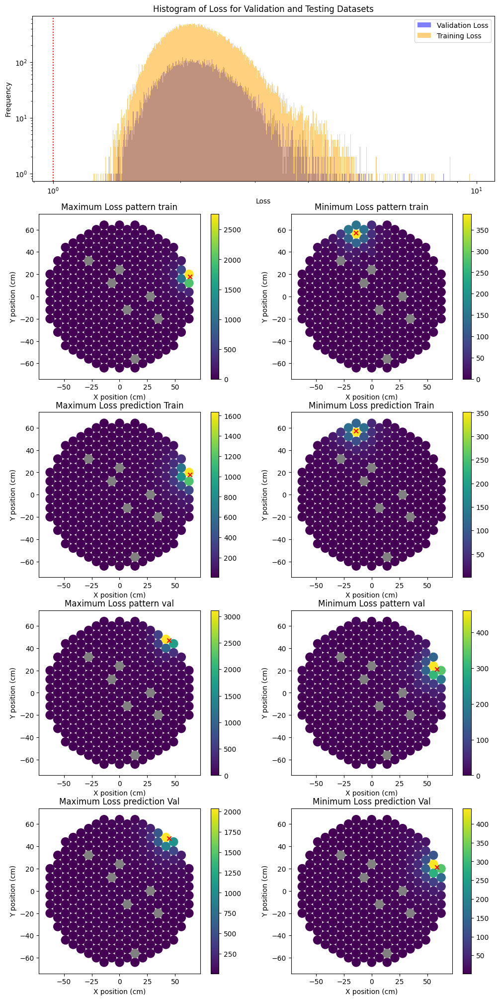

In [100]:
# --------------------------- Last rLCE refit ----------------------------------
n_groups = 4 # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=man_group_4_ring(),
                    I0_init=trivial_lce.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))

x_train = tensorflow.gather(new_new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val    = (tensorflow.gather(new_new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**6,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)

### N_pmt Groups
Using n pmts is either underfit or my epoch learning rate adjustments mess with the results

Had to increase batch size otherwise it takes 48s per epoch

Results:
rLCE train + refit pos
- Didnt improve : 0.0008493434575073469%
- Iteration 0 : 26.097776418828246%
- Iteration 1 : 22.123698381151367%
- Iteration 2 : 19.224889160678796%
- Iteration 3 : 17.227233348621514%
- Iteration 4 : 15.325553347262566%
- Overall Median Value: 2.2432780265808105

rLCE train2 (using refit pos)
- Overall Median Value: 2.1261208057403564

refit pos2 
- Didnt improve : 0.1851568737366016%
- Iteration 0 : 20.774091627172194%
- Iteration 1 : 20.565153136625387%
- Iteration 2 : 19.882280996789483%
- Iteration 3 : 19.433827651225602%
- Iteration 4 : 19.159489714450732%
- Overall Median Value: 2.1180994510650635

rLCE train3 (using refit pos2)
- Overall Median Value: 2.1177239418029785

Running time per cell:
- 
- 
- 
- 


Total
- 

The following Variables were used a Lambda layer's call (lambda_29), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
{'name': 'radial_lce'}
Epoch 1/20
92/92 [==============================] - 7s 72ms/step - loss: 3.6703 - val_loss: 3.6280 - lr: 1.0000e-05
Epoch 2/20
92/92 [==============================] - 7s 72ms/step - loss: 3.6233 - val_loss: 3.5883 - lr: 1.0000e-05
Epoch 3/20
92/92 [==============================] - 7s 71ms/step - loss: 3.5859 - val_loss: 3.5538 - lr: 1.0000e-05
Epoch 4/20
92/92 [==============================] - 7s 71ms/step - loss: 3.5530 - val_loss: 3.5240 - lr: 1.0000e-05
Epoch 5/20
92/92 [==============================] - 7s 71ms/step - loss: 3.5250 - val_loss: 3.4973 - lr: 1.0000e-05
Epoch 6/20
92/92 [===========

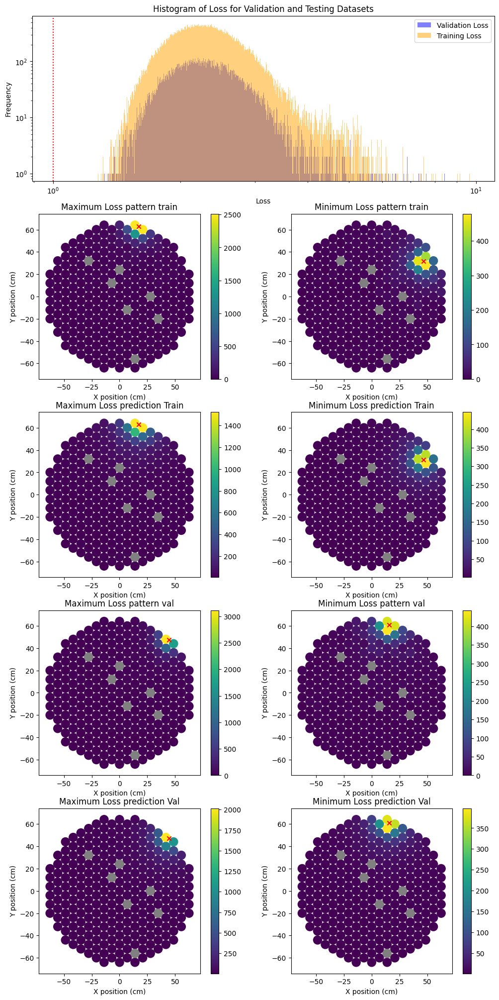

In [101]:
# --- Apply radial LCE with manual groups and jittering of pos using encoder ---
# ----------------------------------- rLCE -------------------------------------

n_groups = n_pmts # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=np.arange(n_pmts).reshape(-1,1),
                    I0_init=trivial_lce.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**10,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

# -------------------------------- pos_updater ---------------------------------
new_pos = train_and_update_pos(positions, patterns, rLCE, n_iter = 5, verbose=0)

x_train = tensorflow.gather(new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


Epoch 1/100
5887/5887 [==============================] - 11s 2ms/step - loss: 205.9201 - val_loss: 203.7827
Epoch 2/100
5887/5887 [==============================] - 10s 2ms/step - loss: 203.9322 - val_loss: 203.7456
Epoch 2: early stopping
The following Variables were used a Lambda layer's call (lambda_32), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
{'name': 'radial_lce'}
Epoch 1/20
1472/1472 [==============================] - 46s 31ms/step - loss: 2.4481 - val_loss: 2.3299 - lr: 1.0000e-05
Epoch 2/20
1472/1472 [==============================] - 46s 31ms/step - loss: 2.2880 - val_loss: 2.2590 - lr: 1.0000e-05
Epoch 3/20
1472/1472 [==============================] - 45s 31ms/step - loss: 2.2478 - val_loss: 2.2435 - lr: 1.0000e-05
Epoch 

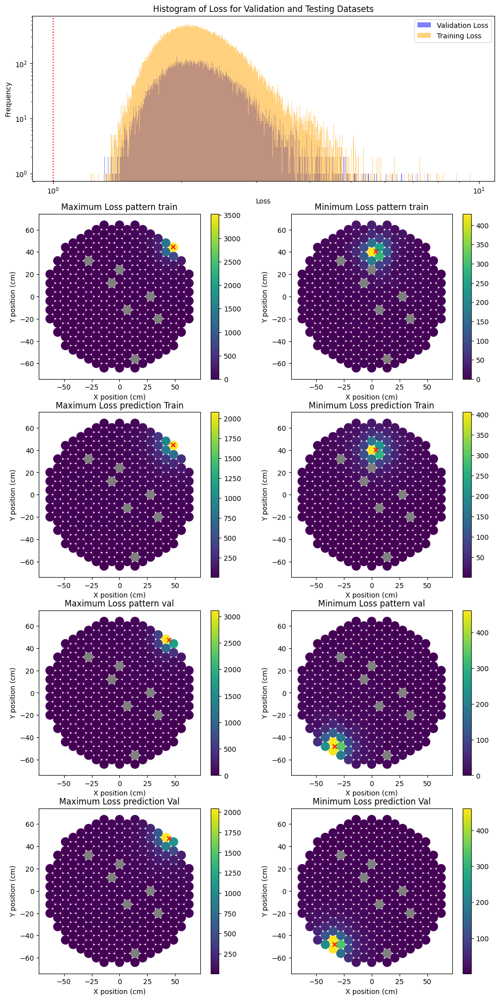

In [102]:
# -------------------------- Refitting pmt response ----------------------------
x_train = tensorflow.gather(new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

trivial_lce_refit = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE,add_noise = False, std = 0.1)
clear_output() # Clear the untracked variable + lambda warning
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=1,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.05,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
trivial_lce_refit.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce_refit.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 100, batch_size = 2**4, 
                callbacks=[early_stopping])

# ------------------------------- Refitting rLCE -------------------------------
n_groups = n_pmts # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=np.arange(n_pmts).reshape(-1,1),
                    I0_init=trivial_lce.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))


early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**6,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


3680/3680 [==============================] - 33s 9ms/step
Jagged iter 0
Epoch 1/20
460/460 [==============================] - 24s 51ms/step - loss: 4.2363 - lr: 0.1000
Epoch 2/20
460/460 [==============================] - 23s 51ms/step - loss: 2.9053 - lr: 0.1000
Epoch 3/20
460/460 [==============================] - 24s 52ms/step - loss: 2.3926 - lr: 0.1000
Epoch 4/20
460/460 [==============================] - 24s 51ms/step - loss: 2.3599 - lr: 0.1000
Epoch 5/20
459/460 [============================>.] - ETA: 0s - loss: 2.4178
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
460/460 [==============================] - 24s 52ms/step - loss: 2.4178 - lr: 0.1000
Epoch 6/20
460/460 [==============================] - 24s 51ms/step - loss: 2.4855 - lr: 0.0500
Epoch 7/20
460/460 [==============================] - 24s 51ms/step - loss: 2.2221 - lr: 0.0500
Epoch 8/20
460/460 [==============================] - 24s 52ms/step - loss: 2.2157 - lr: 0.0500
Epoch 9/20
460/460 [

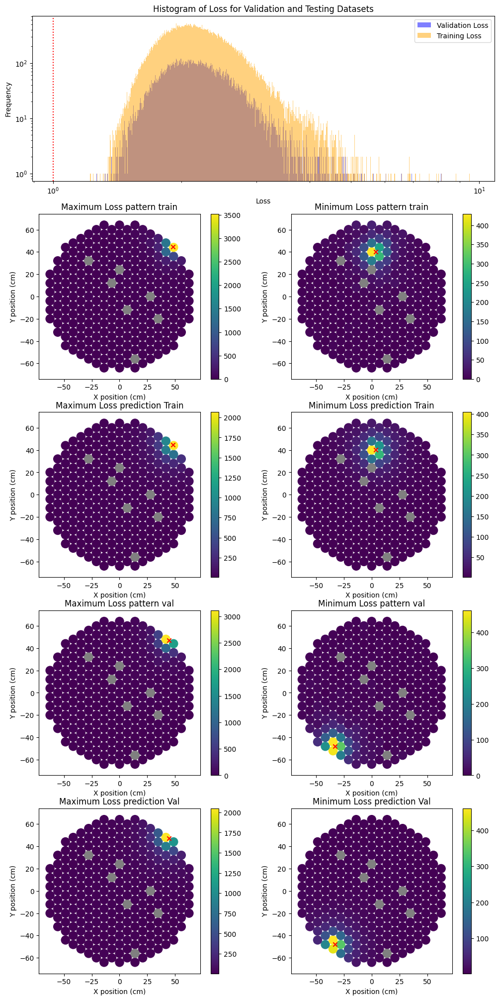

In [103]:
#-------------------------------- new new pos ----------------------------------
new_new_pos = train_and_update_pos(new_pos, patterns, rLCE, n_iter = 5, verbose=0)

x_train = tensorflow.gather(new_new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


The following Variables were used a Lambda layer's call (lambda_34), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
{'name': 'radial_lce'}
Epoch 1/20
1472/1472 [==============================] - 47s 32ms/step - loss: 2.4463 - val_loss: 2.3281 - lr: 1.0000e-05
Epoch 2/20
1472/1472 [==============================] - 46s 31ms/step - loss: 2.2787 - val_loss: 2.2461 - lr: 1.0000e-05
Epoch 3/20
1472/1472 [==============================] - 46s 31ms/step - loss: 2.2353 - val_loss: 2.2325 - lr: 1.0000e-05
Epoch 4/20
1472/1472 [==============================] - ETA: 0s - loss: 2.2238
Epoch 4: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-06.
1472/1472 [==============================] - 46s 31ms/step - loss: 2.2238 - val_loss: 2.229

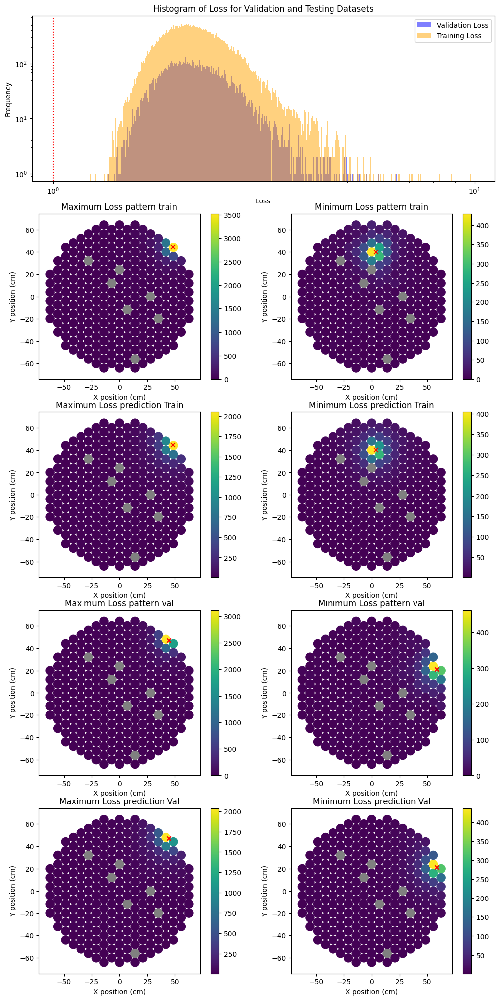

In [104]:
# -------------------------- Refitting pmt response ----------------------------
trivial_lce = get_I0s(positions, patterns, val_slice, train_slice)
# --------------------------- Last rLCE refit ----------------------------------
n_groups = n_pmts # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=np.arange(n_pmts).reshape(-1,1),
                    I0_init=trivial_lce.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))

x_train = tensorflow.gather(new_new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val    = (tensorflow.gather(new_new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**6,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

plot_train_results(rLCE, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)

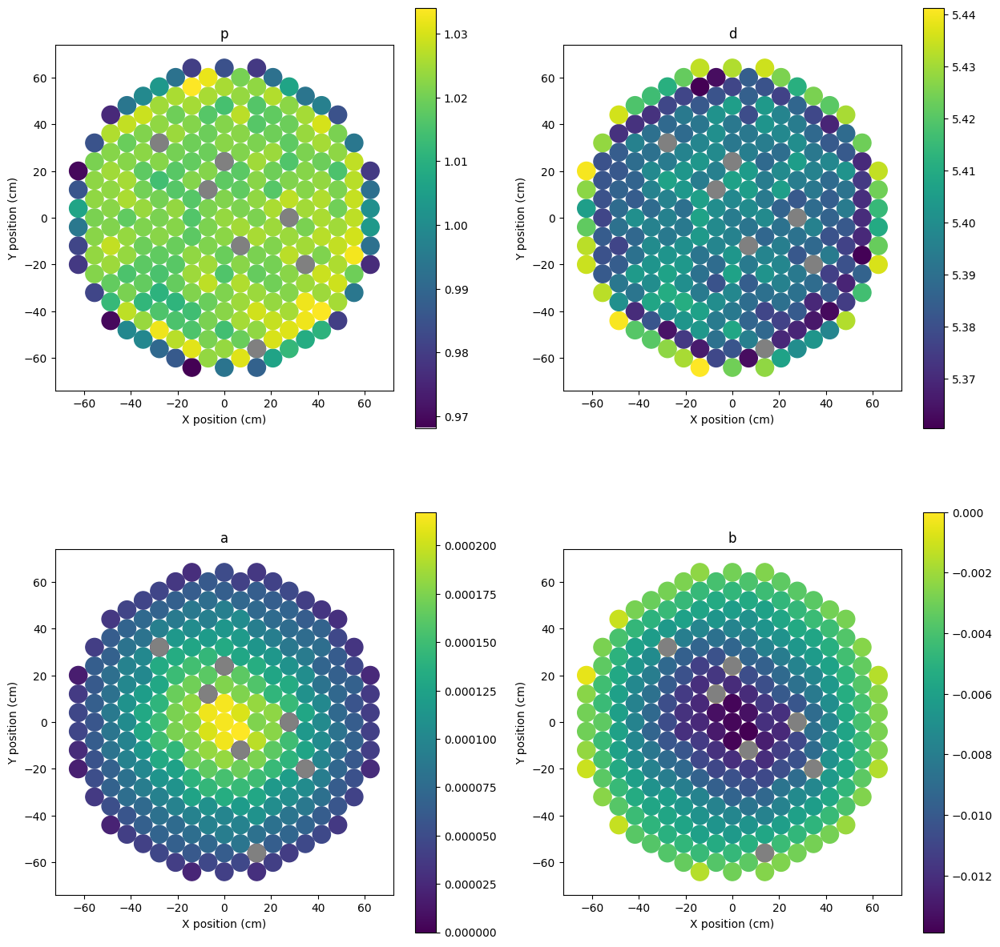

In [105]:
weights = rLCE.get_layer('radial_lce').params.numpy()
fig, ax = plt.subplots(2,2,figsize=(15,15))
ax = ax.flatten()
tmp_dict = {0: 'p', 1: 'd', 2: 'a', 3: 'b'}
for i in range(4):
    plot_pmt_response(pmt_pos_top, weights[:,i], ax=ax[i], title = tmp_dict[i], dead_pmts=dead_pmts)

### TODO

b behaves radially

a remains constant 

d and p have no clear pattern - but appear to be anti correlated

Find a way to aruge why each of these is the case


I believe a can be removed entirely from the model without reprocussion

Check d and p correlation, check how to merge them into a singular variable term - this should definitely be possble

Also try applying instead of radial lce a power series from say -2 to 3

In [106]:
# Plot radial behavior for different PMT's

## Full Chain to CNN LCE

In [15]:
def get_neural_LCE(n_pmts, pmt_pos, I0_init, activation ='relu', final_activation='sigmoid'):
    input = keras.layers.Input(shape=(2))
    # Model to generate relevant coordinates
    m = get_full_LCE_coordinate_model(n_pmts, pmt_pos, n_pmt_pos = 6)(input)
    m = keras.layers.Conv1D(filters=60, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=30, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=15, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=15, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=1, kernel_size=1, activation=final_activation)(m)
    m = keras.layers.Flatten()(m)
    # Add I0 and normalization layers
    m = I0Layer(n_pmts, init_val= 0.1, name='QE_Layer')(m)
    m = NormalizationLayer()(m)
    return keras.Model(inputs=input, outputs=m, name='neural_lce')


In [198]:
# ------------------- Train rLCE to generate new_pos ---------------------------
# -------------------------- Fitting pmt response ------------------------------
x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

trivial_lce_refit = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE,add_noise = False, std = 0.1)
clear_output() # Clear the untracked variable + lambda warning
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=1,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.05,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
trivial_lce_refit.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce_refit.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 100, batch_size = 2**4, 
                callbacks=[early_stopping])
# ----------------------------------- rLCE -------------------------------------
n_groups = n_pmts # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=np.arange(n_pmts).reshape(-1,1),
                    I0_init=trivial_lce.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce.get_layer('I0Layer').weights) 
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))

early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    
    restore_best_weights=True,
    patience=10,     
    min_delta=0.03,  
    mode='min',      
    verbose=1        
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',    
    mode = 'min',
    factor=0.5,            
    patience=2,            
    min_delta=0.03,        
    min_lr=1e-8,           
    verbose=1              
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**10,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

# -------------------------------- pos_updater ---------------------------------
# 1.85 with 5 iterations 1.81 with twenty (1.86 pre nn fit)
new_pos = train_and_update_pos(positions, patterns, rLCE, n_iter = 20, verbose=0)

x_train = tensorflow.gather(new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

Epoch 1/100
5887/5887 [==============================] - 8s 1ms/step - loss: 205.9262 - val_loss: 203.7794
Epoch 2/100
5887/5887 [==============================] - 9s 2ms/step - loss: 203.9337 - val_loss: 203.7600
Epoch 2: early stopping
{'name': 'radial_lce'}
Epoch 1/20
92/92 [==============================] - 8s 83ms/step - loss: 3.6696 - val_loss: 3.6275 - lr: 1.0000e-05
Epoch 2/20
92/92 [==============================] - 8s 83ms/step - loss: 3.6221 - val_loss: 3.5866 - lr: 1.0000e-05
Epoch 3/20
92/92 [==============================] - 8s 83ms/step - loss: 3.5838 - val_loss: 3.5503 - lr: 1.0000e-05
Epoch 4/20
92/92 [==============================] - 8s 83ms/step - loss: 3.5505 - val_loss: 3.5196 - lr: 1.0000e-05
Epoch 5/20
92/92 [==============================] - 8s 83ms/step - loss: 3.5215 - val_loss: 3.4933 - lr: 1.0000e-05
Epoch 6/20
92/92 [==============================] - 8s 83ms/step - loss: 3.4968 - val_loss: 3.4721 - lr: 1.0000e-05
Epoch 7/20
92/92 [=========================

{'name': 'trivial_lce_layer'}
Epoch 1/100
5887/5887 [==============================] - 8s 1ms/step - loss: 205.9428 - val_loss: 203.7721
Epoch 2/100
5887/5887 [==============================] - 10s 2ms/step - loss: 203.9343 - val_loss: 203.7510
Epoch 2: early stopping
The following Variables were used a Lambda layer's call (lambda_71), but
are not present in its tracked objects:
  <tf.Variable 'Variable:0' shape=(253, 2) dtype=float32>
It is possible that this is intended behavior, but it is more likely
an omission. This is a strong indication that this layer should be
formulated as a subclassed Layer rather than a Lambda layer.
Epoch 1/100
5887/5887 [==============================] - 17s 3ms/step - loss: 5.3427 - val_loss: 2.6780 - lr: 1.0000e-04
Epoch 2/100
5887/5887 [==============================] - 17s 3ms/step - loss: 2.3280 - val_loss: 2.1625 - lr: 1.0000e-04
Epoch 3/100
5887/5887 [==============================] - 17s 3ms/step - loss: 2.0924 - val_loss: 2.0500 - lr: 1.0000e-04


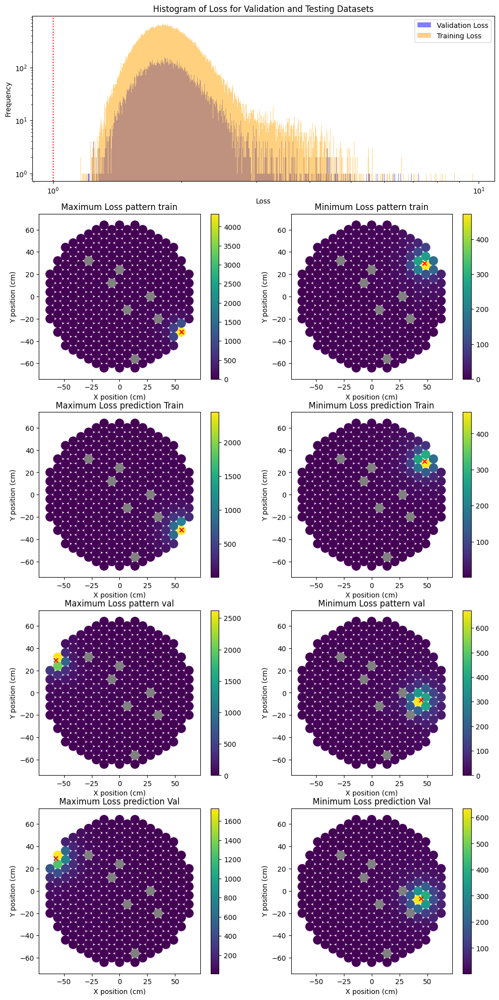

In [199]:
# -------------------------- Fitting pmt response ------------------------------
trivial_lce_refit = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE,add_noise = False, std = 0.1)
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=1,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.05,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
trivial_lce_refit.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce_refit.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 100, batch_size = 2**4, 
                callbacks=[early_stopping])
#-------------------------------- Neural LCE -----------------------------------
neural_lce = get_neural_LCE(n_pmts=n_pmts, 
                            pmt_pos=pmt_pos_top[:,2:], 
                            I0_init=trivial_lce.get_layer('I0Layer').weights, 
                            activation ='relu', 
                            final_activation='sigmoid')

neural_lce.get_layer("QE_Layer").set_weights(trivial_lce.get_layer('I0Layer').weights)
neural_lce.get_layer("QE_Layer").trainable = False

neural_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-4))

early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    #restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
neural_lce.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 100, batch_size = 2**4,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0
nn_pos = train_and_update_pos(new_pos, patterns, neural_lce, n_iter = 5, verbose=0)

x_train = tensorflow.gather(nn_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(nn_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

plot_train_results(neural_lce, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


## Distribution of new pos

I assume the model did preferentially move events closer to the max PMT position, especially after cnn

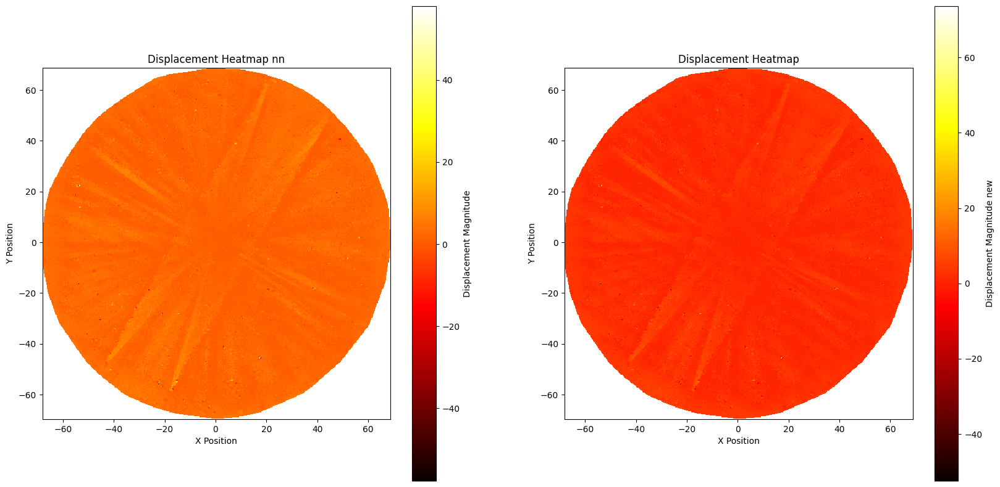

In [236]:
from scipy.interpolate import griddata
fig, ax = plt.subplots(1, 2, figsize=(20,10))  
ax = ax.flatten()

# Compute the displacement (Euclidean distance)
displacement = np.sqrt((nn_pos[:, 0] - positions[:, 0])**2 + 
                       (nn_pos[:, 1] - positions[:, 1])**2)

# Combine old positions and displacements into one array for interpolation
points = positions  # Old positions (x, y)
values = displacement   # Displacement magnitudes

# Create a grid for interpolation (optional)
grid_x, grid_y = np.mgrid[
    np.min(points[:, 0]):np.max(points[:, 0]):500j,  # Adjust grid resolution (500j means 500x500)
    np.min(points[:, 1]):np.max(points[:, 1]):500j
]
# Interpolate displacement magnitudes onto the grid
grid_z = griddata(points, values, (grid_x, grid_y), method='cubic')
cax = ax[0].imshow(grid_z.T, extent=(np.min(points[:, 0]), np.max(points[:, 0]), 
                                  np.min(points[:, 1]), np.max(points[:, 1])),
                origin='lower', cmap='hot', interpolation='nearest')
# Add a colorbar to the plot
fig.colorbar(cax, ax=ax[0], label='Displacement Magnitude')
# Add titles and labels
ax[0].set_title('Displacement Heatmap nn')
ax[0].set_xlabel('X Position')
ax[0].set_ylabel('Y Position')

# Compute the displacement (Euclidean distance)
displacement = np.sqrt((new_pos[:, 0] - positions[:, 0])**2 + 
                       (new_pos[:, 1] - positions[:, 1])**2)

# Combine old positions and displacements into one array for interpolation
points = positions  # Old positions (x, y)
values = displacement   # Displacement magnitudes

# Create a grid for interpolation (optional)
grid_x, grid_y = np.mgrid[
    np.min(points[:, 0]):np.max(points[:, 0]):500j,  # Adjust grid resolution (500j means 500x500)
    np.min(points[:, 1]):np.max(points[:, 1]):500j
]
# Interpolate displacement magnitudes onto the grid
grid_z = griddata(points, values, (grid_x, grid_y), method='cubic')
cax = ax[1].imshow(grid_z.T, extent=(np.min(points[:, 0]), np.max(points[:, 0]), 
                                  np.min(points[:, 1]), np.max(points[:, 1])),
                origin='lower', cmap='hot', interpolation='nearest')
# Add a colorbar to the plot
fig.colorbar(cax, ax=ax[1], label='Displacement Magnitude new')
# Add titles and labels
ax[1].set_title('Displacement Heatmap')
ax[1].set_xlabel('X Position')
ax[1].set_ylabel('Y Position')




# Show the plot
plt.show()

In [20]:
from scipy.stats import binned_statistic_2d

def bindif_2d(p1, p2, bins=30):
    bsx = binned_statistic_2d(p1[:,0], p1[:,1], (p2-p1)[:,0], bins=bins, statistic='median')
    bsy = binned_statistic_2d(p1[:,0], p1[:,1], (p2-p1)[:,1], bins=bins, statistic='median')
    xcenters = (bsx.x_edge[1:] + bsx.x_edge[:-1])/2
    ycenters = (bsx.y_edge[1:] + bsx.y_edge[:-1])/2
    return xcenters, ycenters, bsx.statistic, bsy.statistic
dead_pmts_positions = pmt_pos.to_numpy()[dead_pmts,2:]
pmt_positions = pmt_pos.to_numpy()[:,2:]
def plot_pmts():
    opts = dict(s=10, marker='o', zorder=5, alpha=0.5, edgecolors='none')
    plt.scatter(pmt_positions[:,0] * max_r, pmt_positions[:,1] * max_r, c='k', **opts)
    plt.scatter(dead_pmts_positions[:,0] * max_r, dead_pmts_positions[:,1] * max_r, c='r', **opts)

max_r = tpc_radius
def pos_diff_plot(old_pos, new_pos, vmax=2, s=0.15, dpi=200, save=None):
    difs = np.linalg.norm(new_pos - old_pos, axis=1) 
    f, axes = plt.subplots(1, 2, figsize=(20, 10))
    
    for i, (x, title) in enumerate(
            ([old_pos, 'Old positions'], [new_pos, 'New positions'])):
        plt.sca(axes[i])
        
        plot_pmts()
        plt.scatter(
            x[:, 0],
            x[:, 1],
            c=difs,
            s=s,
            vmin=0, vmax=vmax,
            edgecolors='none', 
            cmap=plt.cm.jet)
        if i == 1:
            plt.colorbar(label='Distance moved [cm]', ax=axes, extend='max')
            
        x, y, dx, dy = bindif_2d(old_pos , new_pos , bins=50)
        # Have to give indexing='ij' here, if you just give x, y quiver will
        # meshgrid without it.... an
        xx, yy = np.meshgrid(x, y, indexing='ij')
        plt.quiver(xx, yy, dx, dy,
                   angles='xy', scale_units='xy', scale=1)
            
        ax = plt.gca()
        ax.set_aspect(1)
        #plt.set_aspect(1)
        ax.add_artist(plt.Circle((0, 0), max_r, color='k',
                                 linewidth=0.5, alpha=0.5, fill=False,
                                 zorder=10))

        plt.title(title)
        q = 1.1
        plt.xlim(-max_r * q, max_r * q)
        plt.xlabel("X [cm]")
        plt.ylim(-max_r * q, max_r * q)
        plt.xlabel("Y [cm]")
    if save:
        plt.savefig(save, dpi=dpi)
    plt.show()

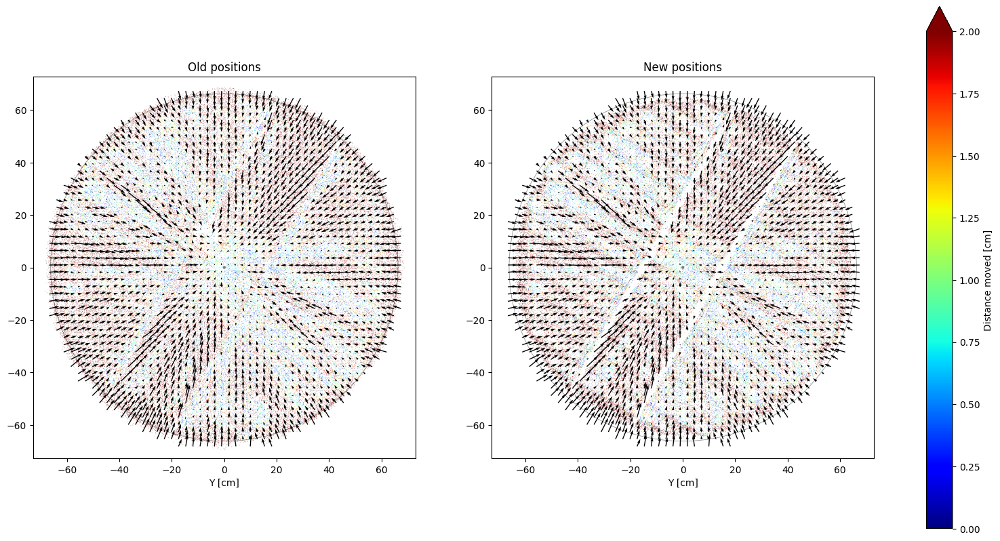

In [237]:
pos_diff_plot(positions, new_pos, vmax=2, s=0.15, dpi=200, save=None)

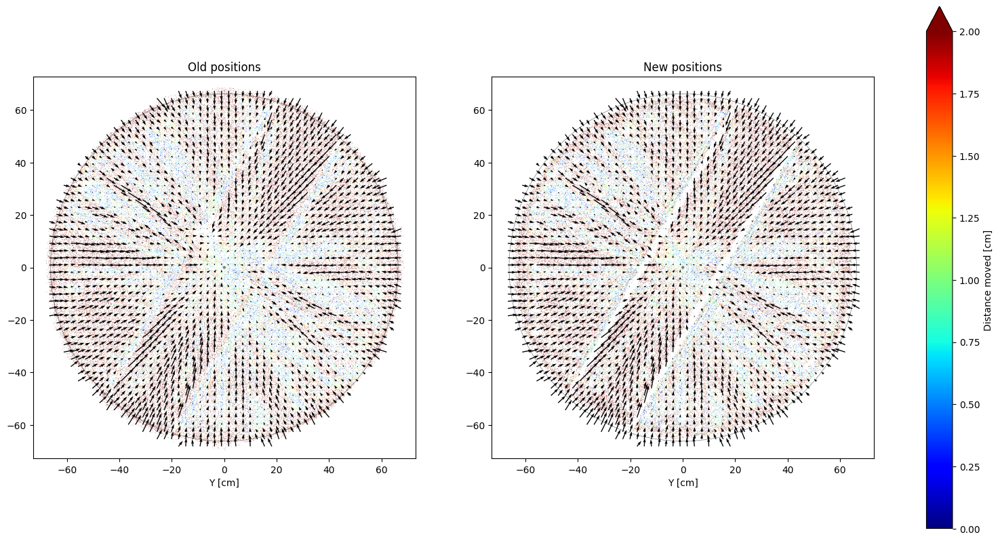

In [238]:
pos_diff_plot(positions, nn_pos, vmax=2, s=0.15, dpi=200, save=None)

Completely frees up the anode wires -> That seems wrong, I assume this is since I did 20 iterations?

Check tmr again with 5, make sure to save intermediates model states, its getting too long to keep rerunning

Also check if refitting the QE's actually does anything 

## Refitting with scaled x, y for nn

In [21]:
# We wil track the change in weights
trained_I0s = []

In [33]:
# ------------------- Train rLCE to generate new_pos ---------------------------
# -------------------------- Fitting pmt response ------------------------------
x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

trivial_lce_refit = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE,add_noise = False, std = 0.1)
clear_output() # Clear the untracked variable + lambda warning
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=1,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.05,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
trivial_lce_refit.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce_refit.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 100, batch_size = 2**4, 
                callbacks=[early_stopping])
# ----------------------------------- rLCE -------------------------------------
n_groups = n_pmts # Using grouping with edges
rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= n_groups,
                    group_slices=np.arange(n_pmts).reshape(-1,1),
                    I0_init=trivial_lce_refit.get_layer('I0Layer').weights,
                    guess = [1, trivial_d, 0, 0],  
                    )
# Already trained this
rLCE.get_layer('QE_Layer').set_weights(trivial_lce_refit.get_layer('I0Layer').weights) 
trained_I0s.append(trivial_lce_refit.get_layer('I0Layer').weights)
rLCE.get_layer('QE_Layer').trainable = False

rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-5))

early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    
    restore_best_weights=True,
    patience=10,     
    min_delta=0.03,  
    mode='min',      
    verbose=1        
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',    
    mode = 'min',
    factor=0.5,            
    patience=2,            
    min_delta=0.03,        
    min_lr=1e-8,           
    verbose=1              
)
rLCE.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 20, batch_size = 2**10,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0

# -------------------------------- pos_updater ---------------------------------
# 1.85 with 5 iterations 1.81 with twenty (1.86 pre nn fit)
new_pos, hist_pos_rlce = train_and_update_pos(positions, patterns, rLCE, n_iter = 5, verbose=0, hist_pos=True)

x_train = tensorflow.gather(new_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(new_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

Epoch 1/100
5887/5887 [==============================] - 10s 2ms/step - loss: 205.9207 - val_loss: 203.7907
Epoch 2/100
5887/5887 [==============================] - 8s 1ms/step - loss: 203.9332 - val_loss: 203.7419
Epoch 2: early stopping
{'name': 'radial_lce'}
Epoch 1/20
92/92 [==============================] - 8s 84ms/step - loss: 3.6701 - val_loss: 3.6278 - lr: 1.0000e-05
Epoch 2/20
92/92 [==============================] - 8s 82ms/step - loss: 3.6227 - val_loss: 3.5870 - lr: 1.0000e-05
Epoch 3/20
92/92 [==============================] - 7s 81ms/step - loss: 3.5845 - val_loss: 3.5522 - lr: 1.0000e-05
Epoch 4/20
92/92 [==============================] - 8s 82ms/step - loss: 3.5507 - val_loss: 3.5219 - lr: 1.0000e-05
Epoch 5/20
92/92 [==============================] - 8s 83ms/step - loss: 3.5218 - val_loss: 3.4944 - lr: 1.0000e-05
Epoch 6/20
92/92 [==============================] - 8s 82ms/step - loss: 3.4974 - val_loss: 3.4716 - lr: 1.0000e-05
Epoch 7/20
92/92 [========================

{'name': 'trivial_lce_layer'}
Epoch 1/100
5887/5887 [==============================] - 11s 2ms/step - loss: 205.9268 - val_loss: 203.7791
Epoch 2/100
5887/5887 [==============================] - 9s 2ms/step - loss: 203.9340 - val_loss: 203.7520
Epoch 2: early stopping
Epoch 1/100
5887/5887 [==============================] - 19s 3ms/step - loss: 4.5907 - val_loss: 2.5111 - lr: 1.0000e-04
Epoch 2/100
5887/5887 [==============================] - 19s 3ms/step - loss: 2.2591 - val_loss: 2.1636 - lr: 1.0000e-04
Epoch 3/100
5887/5887 [==============================] - 17s 3ms/step - loss: 2.0845 - val_loss: 2.0469 - lr: 1.0000e-04
Epoch 4/100
5887/5887 [==============================] - 17s 3ms/step - loss: 2.0350 - val_loss: 2.0172 - lr: 1.0000e-04
Epoch 5/100
5887/5887 [==============================] - 17s 3ms/step - loss: 2.0094 - val_loss: 1.9987 - lr: 1.0000e-04
Epoch 6/100
5887/5887 [==============================] - 17s 3ms/step - loss: 1.9905 - val_loss: 1.9905 - lr: 1.0000e-04
Epoch

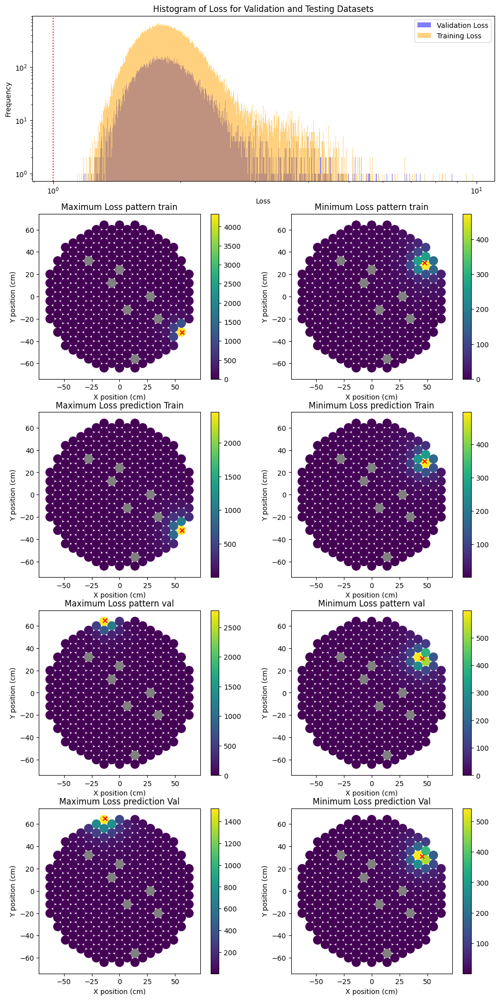

In [82]:
# -------------------------- Fitting pmt response ------------------------------
trivial_lce_refit = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE,add_noise = False, std = 0.1)
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=1,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.05,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
trivial_lce_refit.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce_refit.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 100, batch_size = 2**4, 
                callbacks=[early_stopping])
#-------------------------------- Neural LCE -----------------------------------
neural_lce = get_neural_LCE(n_pmts=n_pmts, 
                            pmt_pos=pmt_pos_top[:,2:], 
                            I0_init=trivial_lce_refit.get_layer('I0Layer').weights, 
                            activation ='relu', 
                            final_activation='sigmoid')

trained_I0s.append(trivial_lce_refit.get_layer('I0Layer').weights)
neural_lce.get_layer("QE_Layer").set_weights(trivial_lce_refit.get_layer('I0Layer').weights)
neural_lce.get_layer("QE_Layer").trainable = False

neural_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-4))

early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    #restore_best_weights=True,
    patience=10,            # Wait for 2 epochs with no improvement
    min_delta=0.03,        # Minimum change of 2% (0.02 in terms of loss improvement)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.03,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)
neural_lce.fit(x = x_train, y = y_train, 
         validation_data=val, epochs = 100, batch_size = 2**4,
         callbacks=[early_stopping,reduce_lr]) #, verbose=0
nn_pos, hist_pos_nn = train_and_update_pos(new_pos, patterns, neural_lce, n_iter = 5, verbose=0, hist_pos=True)

x_train = tensorflow.gather(nn_pos, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(nn_pos, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

plot_train_results(neural_lce, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)


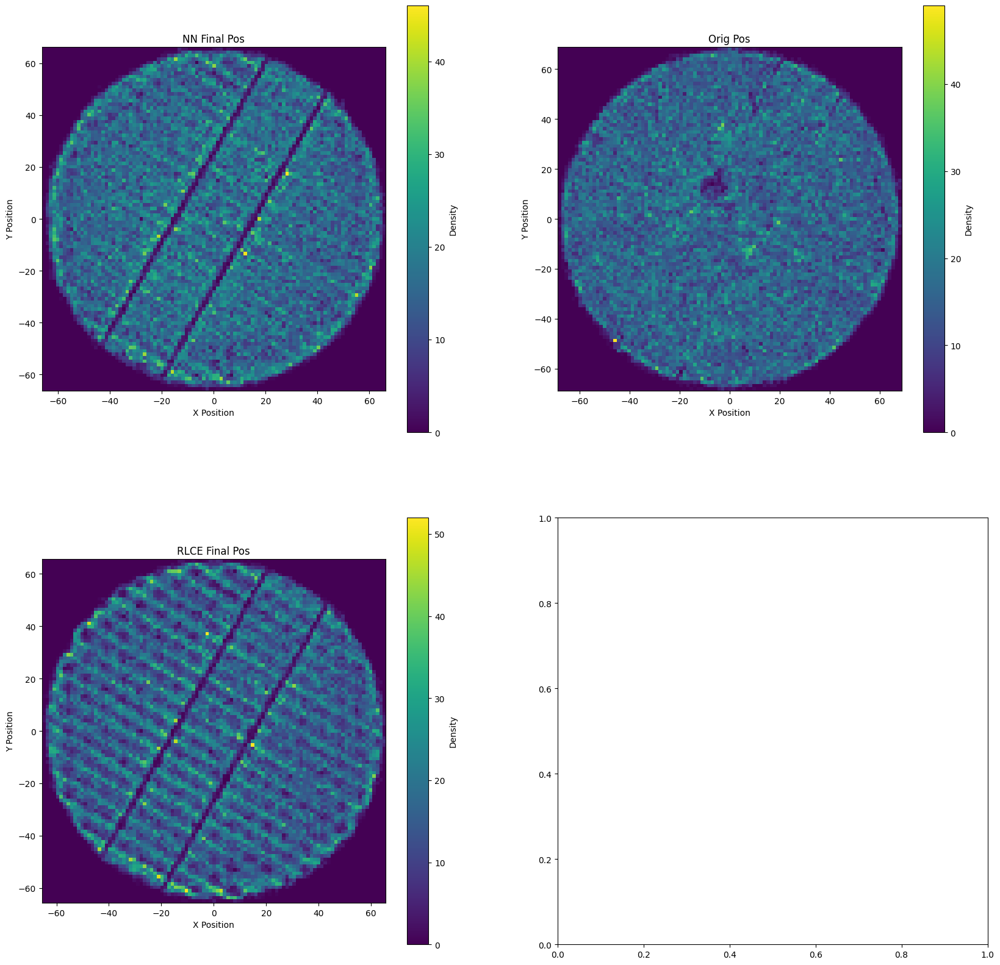

In [104]:
## Density Plots
def do_density_plot(ax, pos,title=''):
    radius = np.abs(np.max(pos))
    x_edges = y_edges = np.linspace(-radius, radius, 100)
    hist, xedges, yedges = np.histogram2d(pos[:, 0], pos[:, 1], bins=[x_edges, y_edges])
    im = ax.imshow(hist.T, origin='lower', extent=[-radius, radius, -radius, radius], cmap='viridis')
    plt.colorbar(im, label='Density', ax=ax)
    ax.set_xlabel('X Position')
    ax.set_ylabel('Y Position')
    ax.set_title(title)
fig, ax = plt.subplots(2,2, figsize=(20,20))
ax = ax.flatten()
# Plot the density map
do_density_plot(ax[0], nn_pos, title='NN Final Pos')
do_density_plot(ax[1], positions, title='Orig Pos')
do_density_plot(ax[2], new_pos, title='RLCE Final Pos')

/tmp/ipykernel_465/3988730545.py:5: RuntimeWarning: invalid value encountered in divide
  tmp = trained_I0s[-1][0].numpy()/trained_I0s[0][0].numpy()


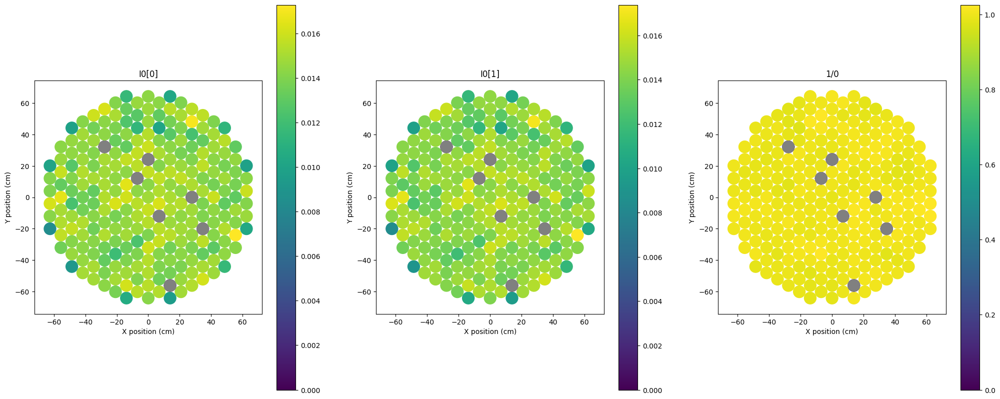

In [96]:
## I0's (-1 since i had to run the cell multiple times)
fig, ax = plt.subplots(1,3, figsize=(25,10))
_ = plot_pmt_response(pmt_pos_top, response=trained_I0s[0][0].numpy(), ax = ax[0], title="I0[0]", vmax=None, vmin=None, logscale=False, dead_pmts=dead_pmts)
_ = plot_pmt_response(pmt_pos_top, response=trained_I0s[-1][0].numpy(), ax = ax[1], title="I0[1]", vmax=None, vmin=None, logscale=False, dead_pmts=dead_pmts)
tmp = trained_I0s[-1][0].numpy()/trained_I0s[0][0].numpy()
tmp[np.isnan(tmp)] =0
_ = plot_pmt_response(pmt_pos_top, response=tmp, ax = ax[2], title="1/0", vmax=None, vmin=None, logscale=False, dead_pmts=dead_pmts)


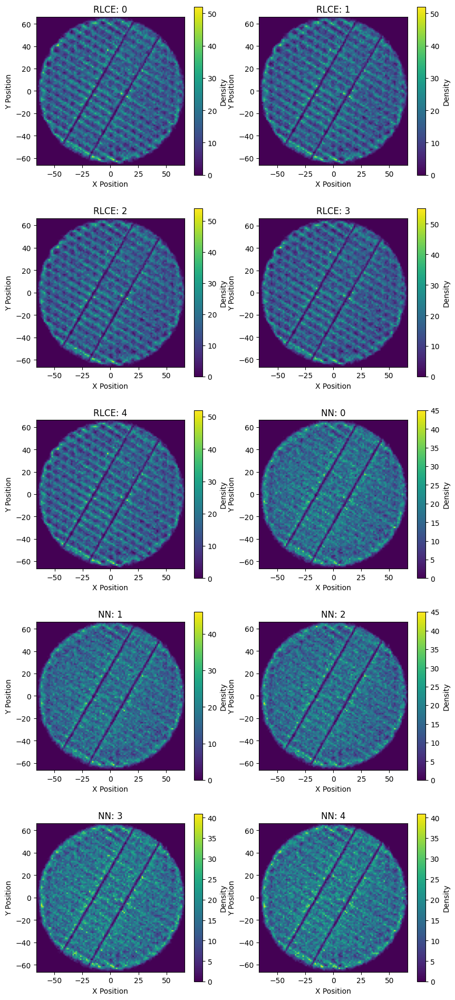

In [106]:
# Trained positions -> Per iteration
fig, ax = plt.subplots(5,2, figsize=(10,24))
ax = ax.flatten()
# Plot the density map
for i in range(5):
    do_density_plot(ax[i], hist_pos_rlce[i], title='RLCE: {}'.format(i))
for i in range(5):
    do_density_plot(ax[i+5], hist_pos_nn[i], title='NN: {}'.format(i))

In [107]:
nn_pos2, hist_pos_nn = train_and_update_pos(positions, patterns, neural_lce, n_iter = 5, verbose=0, hist_pos=True)

x_train = tensorflow.gather(nn_pos2, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(nn_pos2, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

plot_train_results(neural_lce, (x_train, y_train), val, keras_loss, dead_pmts,pmt_pos_top, vmin = None, bin = 1000)

3680/3680 [==============================] - 10s 3ms/step
Jagged iter 0

Epoch 14: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.

Epoch 18: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
Restoring model weights from the end of the best epoch: 16.

Epoch 20: ReduceLROnPlateau reducing learning rate to 0.012500000186264515.
Epoch 20: early stopping
Jagged iter 1

Epoch 14: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.

Epoch 18: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
Restoring model weights from the end of the best epoch: 16.

Epoch 20: ReduceLROnPlateau reducing learning rate to 0.012500000186264515.
Epoch 20: early stopping


KeyboardInterrupt: 

In [ ]:
# Trained positions -> Per iteration
fig, ax = plt.subplots(5,1, figsize=(10,24))
ax = ax.flatten()
# Plot the density map
for i in range(5):
    do_density_plot(ax[i], hist_pos_nn[i], title='NN from pos: {}'.format(i))

In [ ]:
How good old positions
why not see artifact orig 
How do LCE look

Compare MC maps
And use sim dat

Write note